In [382]:
import sys
import os
sys.path.append('/root/capsule/code/beh_ephys_analysis')
from harp.clock import decode_harp_clock, align_timestamps_to_anchor_points
from open_ephys.analysis import Session
import datetime
from aind_ephys_rig_qc.temporal_alignment import search_harp_line
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd
from pynwb import NWBFile, TimeSeries, NWBHDF5IO
from scipy.io import loadmat
from scipy.stats import zscore
import ast
from utils.plot_utils import combine_pdf_big

from open_ephys.analysis import Session
from pathlib import Path
import glob

import json
import seaborn as sns
from PyPDF2 import PdfMerger
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import re
from aind_dynamic_foraging_basic_analysis.plot.plot_foraging_session import plot_foraging_session
from aind_dynamic_foraging_data_utils.nwb_utils import load_nwb_from_filename
from hdmf_zarr.nwb import NWBZarrIO
from utils.beh_functions import session_dirs, parseSessionID, load_model_dv, makeSessionDF, get_session_tbl, get_unit_tbl, get_history_from_nwb
from utils.ephys_functions import*
from utils.ccf_utils import ccf_pts_convert_to_mm
import pandas as pd
import pickle
import scipy.stats as stats
from joblib import Parallel, delayed
from multiprocessing import Pool
from functools import partial
import time
import spikeinterface as si
import shutil 
import seaborn as sns
import math  
import seaborn as sns
from sklearn.decomposition import PCA
from scipy.stats import zscore
from trimesh import load_mesh
from scipy.optimize import minimize
from scipy.linalg import null_space
from joblib import Parallel, delayed

%matplotlib inline

In [383]:
criteria_name = 'waveform_large'

In [384]:
# load constraints and data
with open(os.path.join('/root/capsule/scratch/combined/combine_unit_tbl', 'combined_unit_tbl.pkl'), 'rb') as f:
    combined_tagged_units = pickle.load(f)
with open(os.path.join('/root/capsule/scratch/combined/metrics', f'{criteria_name}.json'), 'r') as f:
    constraints = json.load(f)
wf_folder = os.path.join('/root/capsule/scratch/combined/wf_plots', criteria_name)
if not os.path.exists(wf_folder):
    os.makedirs(wf_folder)
# start with a mask of all True
mask = pd.Series(True, index=combined_tagged_units.index)

In [385]:
for col, cfg in constraints.items():
    if col not in combined_tagged_units.columns:
        continue

    # Numeric range?
    if "bounds" in cfg:
        print(f'Applying bounds for {col}: {cfg["bounds"]}')
        lb, ub = np.array(cfg["bounds"], dtype=float)  # np.nan for null
        if not np.isnan(lb):
            mask &= combined_tagged_units[col] >= lb
        if not np.isnan(ub):
            mask &= combined_tagged_units[col] <= ub

    # Categorical list?
    elif "items" in cfg:
        print(f'Applying items for {col}: {cfg["items"]}')
        allowed = cfg["items"]
        mask &= combined_tagged_units[col].isin(allowed)

# apply and get filtered DataFrame
combined_tagged_units_filtered = combined_tagged_units[mask].reset_index(drop=True)
combined_tagged_units['selected'] = mask
print(f'Number of units after filtering: {len(combined_tagged_units_filtered)}')

Applying bounds for isi_violations: [0.0, 0.5]
Applying bounds for p_max: [0.5, 1.0]
Applying bounds for lat_max_p: [0.005, 0.02]
Applying bounds for eu: [0.0, 0.25]
Applying bounds for corr: [0.95, 1.0]
Applying items for qc_pass: [True]
Applying bounds for peak: [-1000, -50]
Applying items for probe: ['2']
Number of units after filtering: 167


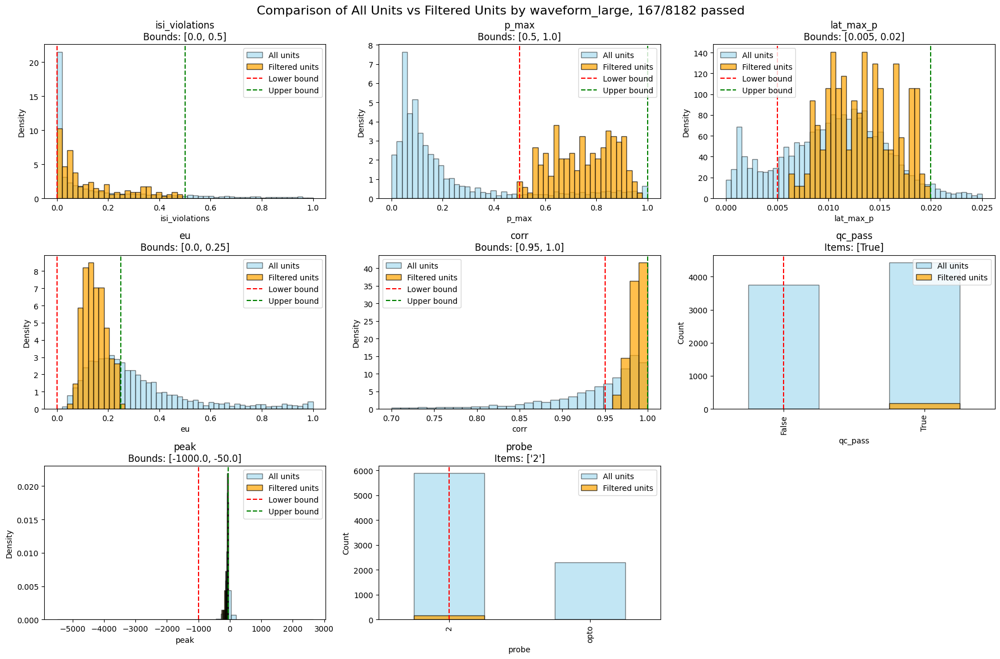

In [213]:
valid_constraints = {col: cfg for col, cfg in constraints.items() if col in combined_tagged_units.columns}
n = len(valid_constraints)

ncols = 3
nrows = math.ceil(n / ncols)

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 6, nrows * 4))
axes = axes.flatten()

for i, (col, cfg) in enumerate(valid_constraints.items()):
    ax = axes[i]
    full_data = combined_tagged_units[col].dropna()
    filtered_data = combined_tagged_units_filtered[col].dropna()

    if "bounds" in cfg:
        lb, ub = np.array(cfg["bounds"], dtype=float)
        bins = 50

        match col:
            case 'isi_violations':
                bins =  np.linspace(0, 1, 50)
            case 'eu':
                bins =  np.linspace(0, 1, 50)
            case 'corr':
                bins =  np.linspace(0.7, 1, 30)
            case 'p_max':
                bins =  np.linspace(0, 1, 50)
            case 'lat_max_p':
                bins =  np.linspace(0, 0.025, 50)
        ax.hist(full_data, bins=bins, color='skyblue', edgecolor='black', alpha=0.5, label='All units', density=True)
        ax.hist(filtered_data, bins=bins, color='orange', edgecolor='black', alpha=0.7, label='Filtered units', density=True)

        ax.set_title(f'{col}\nBounds: [{lb}, {ub}]')
        ax.set_xlabel(col)
        ax.set_ylabel('Density')

        if not np.isnan(lb):
            ax.axvline(lb, color='red', linestyle='--', label='Lower bound')
        if not np.isnan(ub):
            ax.axvline(ub, color='green', linestyle='--', label='Upper bound')
        ax.legend()

    elif "items" in cfg:
        full_counts = combined_tagged_units[col].dropna().astype(str).value_counts()
        filtered_counts = combined_tagged_units_filtered[col].dropna().astype(str).value_counts()

        # Get all unique category labels from both datasets
        all_idx = full_counts.index.union(filtered_counts.index)

        # Reindex both with all categories, fill missing with 0
        full_counts = full_counts.reindex(all_idx, fill_value=0)
        filtered_counts = filtered_counts.reindex(all_idx, fill_value=0)

        # Plot
        full_counts.plot(kind='bar', ax=ax, color='skyblue', alpha=0.5, edgecolor='black', label='All units')
        filtered_counts.plot(kind='bar', ax=ax, color='orange', alpha=0.7, edgecolor='black', label='Filtered units')



        for item in cfg["items"]:
            if str(item) in full_counts.index:
                ax.axvline(x=str(item), color='red', linestyle='--')

        ax.set_title(f'{col}\nItems: {cfg["items"]}')
        ax.set_xlabel(col)
        ax.set_ylabel('Count')
        ax.legend()

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f'Comparison of All Units vs Filtered Units by {criteria_name}, {len(combined_tagged_units_filtered)}/{len(combined_tagged_units)} passed', fontsize=16)

plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'Pass_histo_{criteria_name}.pdf'))
# plt.show()


In [214]:
# anti_cvs = '/root/capsule/code/data_management/antidromic_units.csv'
# anti_df = pd.read_csv(anti_cvs)
# data_type = 'curated'

# for i, row in combined_tagged_units_filtered.iterrows():
#     session = row['session']
#     unit = row['unit']
#     session_dir = session_dirs(session)

#     # Get list of all PDFs in opto directory
#     opto_dir = session_dir[f'opto_dir_fig_{data_type}']
#     all_pdfs = os.listdir(opto_dir)
    
#     # Find matching PDF
#     matching_pdfs = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
#     if not matching_pdfs:
#         print(f'No opto pdf found for {session}, {unit}')
#         continue

#     pdf = matching_pdfs[0]
#     pdf_path = os.path.join(opto_dir, pdf)

#     # Copy to general opto folder
#     new_path_opto = os.path.join(opto_folder, f'{session}_{pdf}')
#     shutil.copy(pdf_path, new_path_opto)

#     # Copy to anti_opto_folder if anti_resp is not NaN
#     if pd.notna(row['anti_resp']):
#         new_path_opto = os.path.join(
#             anti_opto_folder,
#             f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}'
#         )
#         shutil.copy(pdf_path, new_path_opto)

#         # Check if anti unit exists
#         if anti_df.query("session == @session and unit_id == @unit").empty:
#             print(f'Error: anti unit not found in anti_df for {session}, {unit}')


In [215]:
# grab all tagged units and combine a pdf
data_type = 'curated'
target = 'soma'
opto_folder = os.path.join(wf_folder, 'opto_tagged')
behavior_folder = os.path.join(wf_folder, 'behavior_tagged_response')
anti_opto_folder = os.path.join(wf_folder, 'anti_opto')
anti_behavior_folder = os.path.join(wf_folder, 'anti_behavior')
shutil.rmtree(opto_folder, ignore_errors=True)
shutil.rmtree(behavior_folder, ignore_errors=True)
shutil.rmtree(anti_opto_folder, ignore_errors=True)
shutil.rmtree(anti_behavior_folder, ignore_errors=True)

os.makedirs(name=opto_folder, exist_ok=True)
os.makedirs(name=behavior_folder, exist_ok=True)
os.makedirs(name=anti_opto_folder, exist_ok=True)
os.makedirs(name=anti_behavior_folder, exist_ok=True)

anti_cvs = '/root/capsule/code/data_management/antidromic_units.csv'
anti_df = pd.read_csv(anti_cvs)

for i, row in combined_tagged_units_filtered.iterrows():
    session = row['session']
    unit = row['unit']
    session_dir = session_dirs(session)
    # opto_file
    all_pdfs = os.listdir(session_dir[f'opto_dir_fig_{data_type}'])
    pdf = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
    if len(pdf) == 0:
        print(f'No opto pdf found for {session}, {unit}')
        continue
    else:
        pdf = pdf[0]
    pdf_path = os.path.join(session_dir[f'opto_dir_fig_{data_type}'], pdf)
    # copy to new path
    new_path_opto = os.path.join(opto_folder, f'{session}_{pdf}')
    _ = shutil.copy(pdf_path, new_path_opto)   
    if ~np.isnan(row['anti_resp']):
        new_path_opto = os.path.join(anti_opto_folder, f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}')
        _ = shutil.copy(pdf_path, new_path_opto)
        if anti_df.query("session == @session and unit_id == @unit").empty:
            print(f'Error anti unit found for {session}, {unit}')
        elif len(anti_df.query("session == @session and unit_id == @unit")) == 1:
            print(f'Correct anti unit found for {session}, {unit}')

    # selected_sessions.append(session)
    # selected_units.append(unit)
    # all_pdf.append(pdf_path)

    # behavior file: go cue
    if row['in_df']:
        all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response'))
        pdf = [pdf for pdf in all_pdfs if f'unit_{int(unit)}_' in pdf and pdf.endswith('.pdf')]
        if len(pdf) == 0:
            print(f'No response pdf found for {session}, {unit}')
            continue
        else:
            pdf = pdf[0]
        pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response', pdf)
        # copy to new path
        new_path_ephys = os.path.join(behavior_folder, f'{session}_{pdf}')
        _ = shutil.copy(pdf_path, new_path_ephys)

        if ~np.isnan(row['anti_resp']):
            new_path_ephys = os.path.join(anti_behavior_folder, f'{session}_{row["proj"]}_tier_{row["anti_resp"]}_{pdf}')
            _ = shutil.copy(pdf_path, new_path_ephys)


Correct anti unit found for ecephys_717120_2024-03-06_12-54-27, 63.0
Correct anti unit found for ecephys_717120_2024-03-06_12-54-27, 65.0
Correct anti unit found for ecephys_717120_2024-03-06_12-54-27, 151.0
Correct anti unit found for behavior_716325_2024-05-31_10-31-14, 197.0
Correct anti unit found for behavior_717121_2024-06-15_10-00-58, 162.0
Correct anti unit found for behavior_751004_2024-12-20_13-26-11, 263.0
Correct anti unit found for behavior_751004_2024-12-21_13-28-28, 192.0
Correct anti unit found for behavior_751769_2025-01-16_11-32-05, 18.0
Correct anti unit found for behavior_751769_2025-01-17_11-37-39, 22.0
Correct anti unit found for behavior_751769_2025-01-17_11-37-39, 25.0
Correct anti unit found for behavior_751769_2025-01-17_11-37-39, 288.0
Correct anti unit found for behavior_751769_2025-01-18_10-15-25, 29.0
Correct anti unit found for behavior_758017_2025-02-04_11-57-38, 5.0
Correct anti unit found for behavior_758017_2025-02-04_11-57-38, 202.0
Correct anti unit

In [216]:
# combine_pdf_big(os.path.join(wf_folder, 'opto_tagged'), os.path.join(wf_folder, 'opto_combined.pdf'))
# combine_pdf_big(os.path.join(wf_folder, 'behavior_tagged_response'), os.path.join(wf_folder, 'behavior_combined.pdf'))

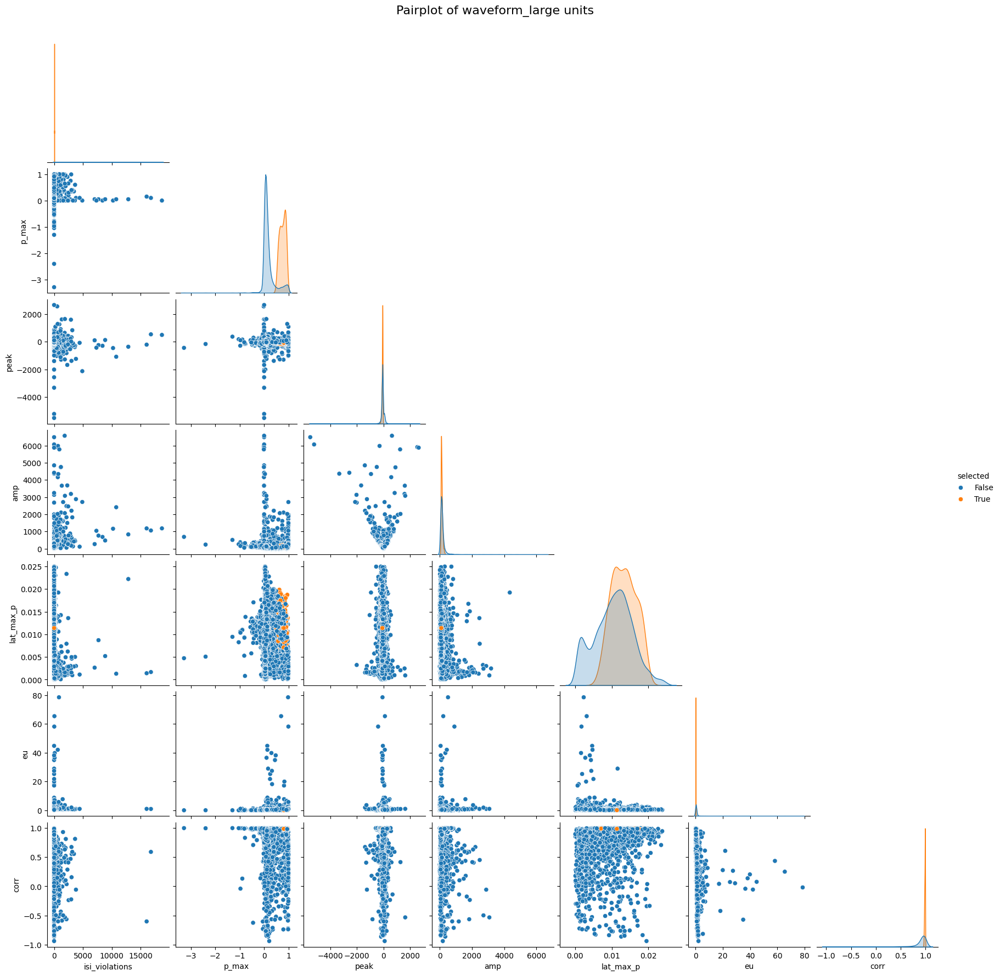

In [217]:
g = sns.pairplot(
        combined_tagged_units[['isi_violations', 'p_max', 'selected', 'peak', 'amp', 'lat_max_p', 'eu', 'corr']],
        hue='selected',
        corner=True,
        diag_kind='auto',
        # plot_kws={'alpha': 0.5, 's': 5}, # 'linewidth': 2, 'facecolor': 'none'},
        diag_kws={'common_norm': False}
    )

# save
g.fig.suptitle(f'Pairplot of {criteria_name} units', y=1.02, fontsize=16)
g.savefig(os.path.join(wf_folder, f'Pass_pairplot_{criteria_name}.pdf'))


In [450]:
# Extract waveform feature
wf_norm = []
wf_2D_norm = []

half_w = []
trough_w = []
pre_half = []
post_half = []
post_w = []

trough_post_ratio_1D = []
trough_pre_ratio_1D = []

post_slope = []
post_space = []
pre_slope = []
pre_space = []

symmetry_inte = []
symmetry_half = []
symmetry_slope = []
symmetry_inte_div = []
symmetry_half_div = []
symmetry_slope_div = []

wf_norm = combined_tagged_units_filtered['wf']/np.abs(combined_tagged_units_filtered['peak'])
wf_2D_norm = combined_tagged_units_filtered['wf_2d']/np.abs(combined_tagged_units_filtered['peak'])
for rows in combined_tagged_units_filtered.iterrows():
    wf = rows[1]['wf']
    peak = rows[1]['peak']
    peak_ind = np.argmin(wf)
    if peak<0:
        curr_trough_loc = np.argmax(wf[peak_ind:])+1
        post_trough = np.max(wf[peak_ind:])
        post_trough_ind = np.argmax(wf[peak_ind:])+1
        pre_trough = np.max(wf[:peak_ind])
        pre_trough_ind = peak_ind - np.argmax(wf[:peak_ind])  
    else:
        curr_trough_loc = np.argmin(wf[peak_ind:])+1
        post_trough = np.min(wf[peak_ind:])
        post_trough_ind = np.argmin(wf[peak_ind:])+1
        pre_trough = np.min(wf[:peak_ind])
        pre_trough_ind = peak_ind - np.argmin(wf[:peak_ind])  
    curr_trough_post = post_trough/peak # positive if same sign, negative if opposite sign
    curr_trough_pre = pre_trough/peak # positive if same sign, negative if opposite sign
    curr_trough_loc_slope_post = (post_trough/peak)/post_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_inte_post = ((peak - pre_trough)/peak)*post_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_slope_pre = ((peak - pre_trough)/peak)/pre_trough_ind # positive if same sign, negative if opposite sign
    curr_trough_loc_inte_pre = ((peak - post_trough)/peak)*pre_trough_ind # positive if same sign, negative if opposite sign

    curr_symmetry_inte = curr_trough_loc_inte_post - curr_trough_loc_inte_pre  # positive if same sign, negative if opposite sign
    curr_symmetry_slope = curr_trough_loc_slope_post - curr_trough_loc_slope_pre  # positive if same sign, negative if opposite sign
    
    

    # find samples where the waveform crosses the half peak threshold to infer half width
    half_peak = peak / 2
    wf_half_crossings = np.where(np.diff(np.sign(wf - half_peak))!=0)[0]
    if len(wf_half_crossings) < 2:
        post_crossing = 0
        pre_crossing = 0
    else: 
        post_crossing = np.min(wf_half_crossings[wf_half_crossings > peak_ind]) - peak_ind
        pre_crossing = peak_ind - np.max(wf_half_crossings[wf_half_crossings < peak_ind])

    half_w.append(post_crossing + pre_crossing)  # half width in samples
    trough_w.append(post_trough_ind + pre_trough_ind)  # trough width in samples
    post_w.append(post_trough_ind)  # post trough width in samples
    pre_half.append(pre_crossing)
    post_half.append(post_crossing)

    trough_post_ratio_1D.append(curr_trough_post)
    trough_pre_ratio_1D.append(curr_trough_pre)

    post_slope.append(curr_trough_loc_slope_post)
    post_space.append(curr_trough_loc_inte_post)
    pre_slope.append(curr_trough_loc_slope_pre)
    pre_space.append(curr_trough_loc_inte_pre)

    symmetry_inte.append(curr_trough_loc_inte_post - curr_trough_loc_inte_pre)
    symmetry_half.append(post_crossing - pre_crossing)
    symmetry_slope.append(curr_trough_loc_slope_post - curr_trough_loc_slope_pre)

    symmetry_inte_div.append(curr_trough_loc_inte_post/curr_trough_loc_inte_pre)
    symmetry_half_div.append(post_crossing/pre_crossing)
    symmetry_slope_div.append(curr_trough_loc_slope_post/curr_trough_loc_slope_pre)


wf_features = pd.DataFrame({'unit_id': combined_tagged_units_filtered['unit'],
                            'session': combined_tagged_units_filtered['session'],
                            'amp': combined_tagged_units_filtered['amp'],
                            'peak': combined_tagged_units_filtered['peak'],
                            'half_w': half_w,
                            'trough_w': trough_w,
                            'pre_half': pre_half,
                            'post_half': post_half,
                            'post_w': post_w,
                            'trough_post_ratio_1D': trough_post_ratio_1D,
                            'trough_pre_ratio_1D': trough_pre_ratio_1D,
                            'post_slope': post_slope,
                            'post_space': post_space,
                            'pre_slope': pre_slope,
                            'pre_space': pre_space,
                            'symmetry_inte': symmetry_inte,
                            'symmetry_half': symmetry_half,
                            'symmetry_slope': symmetry_slope,
                            'symmetry_inte_div': symmetry_inte_div,
                            'symmetry_half_div': symmetry_half_div,
                            'symmetry_slope_div': symmetry_slope_div,
                            'y_loc': combined_tagged_units_filtered['y_loc'],
                            'probe': combined_tagged_units_filtered['probe'],
                            })
                            


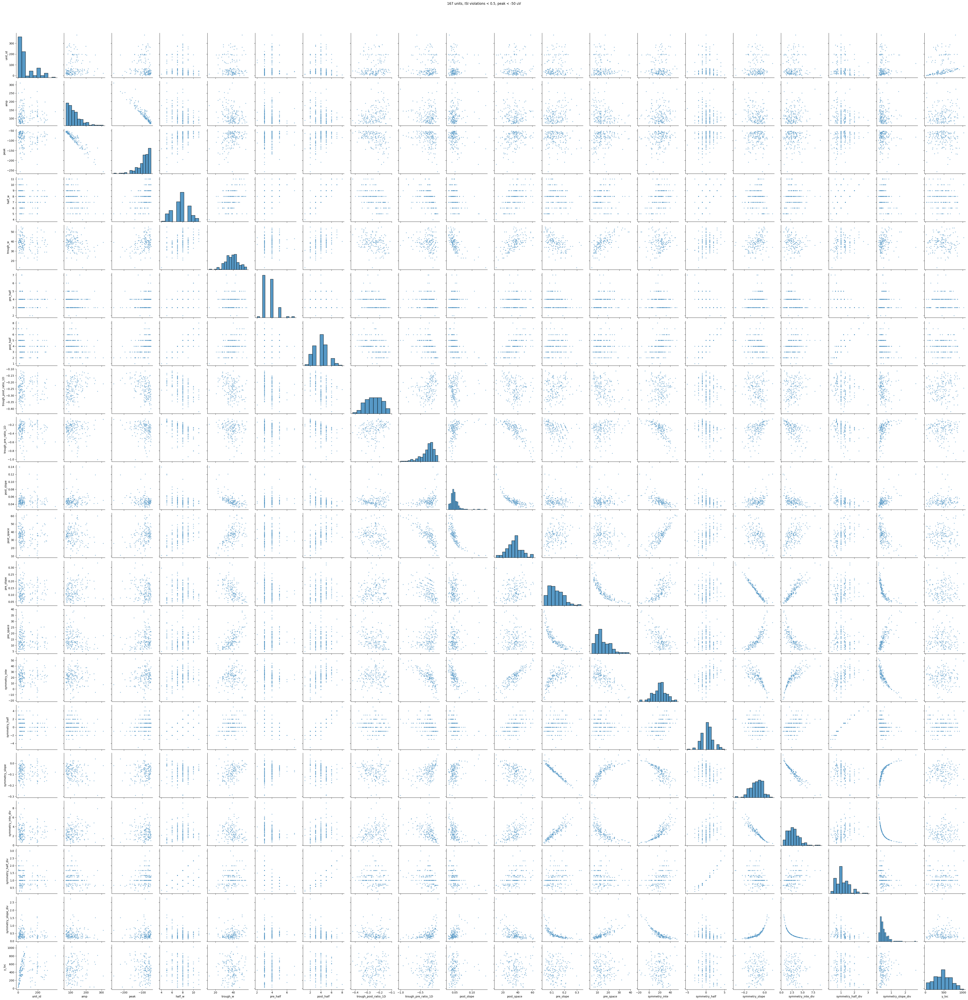

In [219]:
g = sns.pairplot(wf_features, corner=False, 
             plot_kws={'alpha': 0.5, 's': 10},
            #  hue='probe'
             )
# save figure
title = f"{len(wf_features)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
g.fig.suptitle(title, y=1.02)
g.savefig(os.path.join(wf_folder, f'Wf_features_pairplot_{criteria_name}.png'), dpi=300)

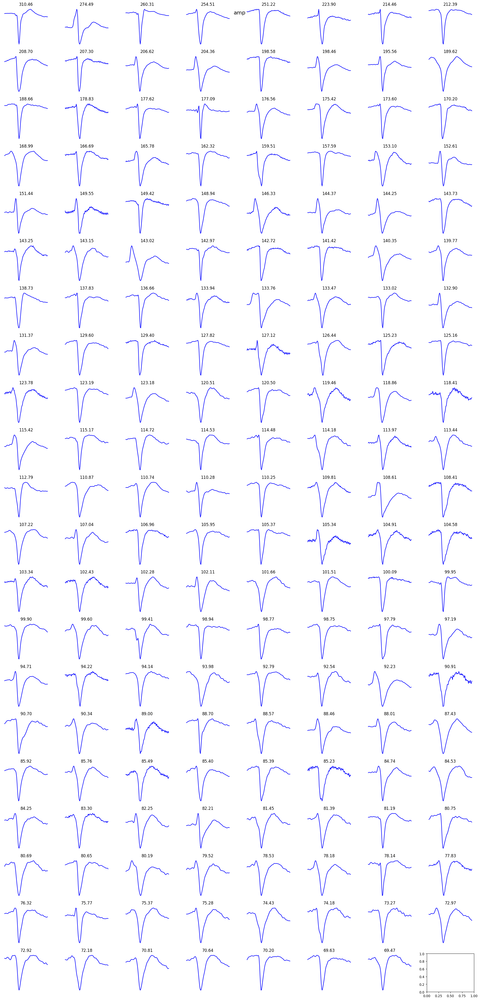

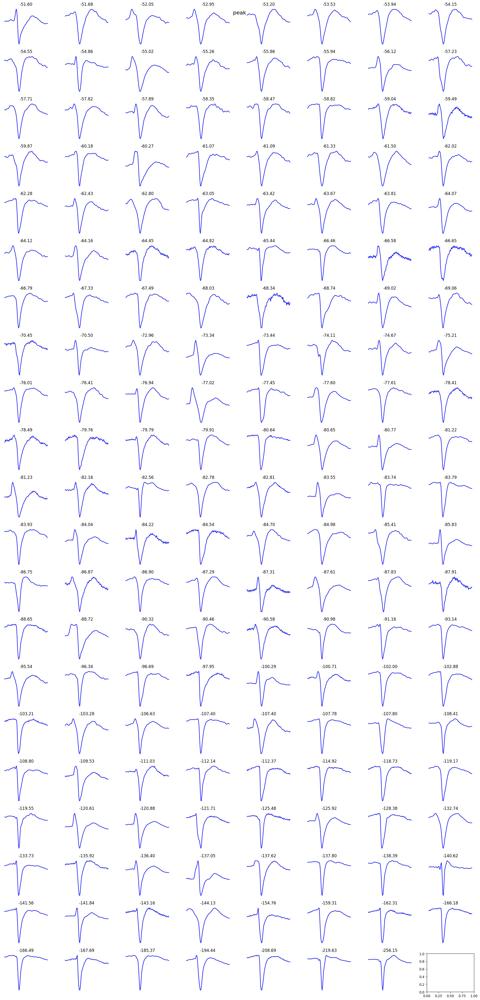

In [220]:
ncols = 8
nrows = int(np.ceil(len(combined_tagged_units_filtered) / ncols))
features = ['amp', 'peak', 'trough_post_ratio_1D', 'fall_slope', 'fall_space', 'symmetry']
for feature in features:
    if feature not in combined_tagged_units_filtered.columns:
        continue
    focus = combined_tagged_units_filtered[feature].values
    resorted = combined_tagged_units_filtered.sort_values(by=feature, ascending=False).reset_index(drop=True)
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 2*nrows))
    for i, row in resorted.iterrows():
        ax = axes[i // ncols, i % ncols]
        wf = row['wf']
        peak = row['peak']
        ax.plot(wf/np.abs(peak), color='blue')
        # remove x and y axis
        ax.axis('off')
        ax.set_title(f'{row[feature]:.2f}')
    plt.suptitle(feature, fontsize=16)
    plt.tight_layout()
    fig.savefig(fname=os.path.join(wf_folder, f'{feature}_wf.png'), dpi=300, bbox_inches='tight')

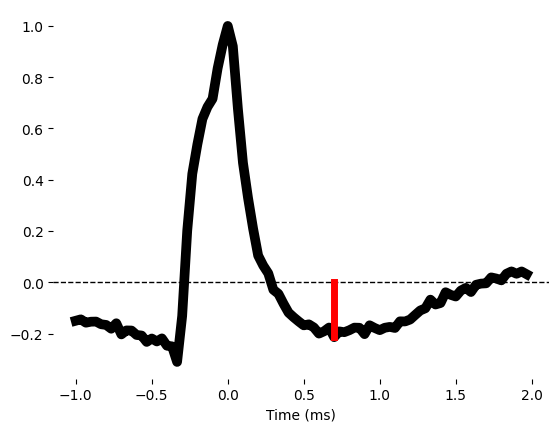

In [492]:
cell_ind =25
time = (np.arange(90)-30)*(1000/30000)
plt.plot(time, -wf_norm[cell_ind], linewidth=7, color='k')
plt.xlabel('Time (ms)')
plt.axhline(y=0, color='k', linestyle='--', linewidth=1)
plt.xlim()
# 
ind = np.argmin(np.abs(wf_norm[cell_ind][30:]+trough_post_ratio_1D[cell_ind])) + 30
# plt.axhline(trough_post_ratio_1D[cell_ind], color='r', linestyle='--', linewidth=5)
plt.plot([time[ind], time[ind]], [0, trough_post_ratio_1D[cell_ind]], color='r', linewidth=5)
# plt.scatter(ind[0]*(1000/30000), trough_post_ratio_1D[0])
# turn off box
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.savefig(os.path.join(wf_folder, f'{cell_ind}_wf_AHP.pdf'), dpi=300, bbox_inches='tight')


In [443]:
# grab all tagged units and combine spike waveforms
data_type = 'curated'
target = 'soma'
selected_sessions = []
selected_units = []
all_pdf = []
all_wfs = []
all_peaks = [] 
curr_session = None

all_wfs = combined_tagged_units_filtered['wf'].tolist()
all_wfs_aligned = combined_tagged_units_filtered['wf_aligned'].tolist()
all_peaks = combined_tagged_units_filtered['peak'].tolist()

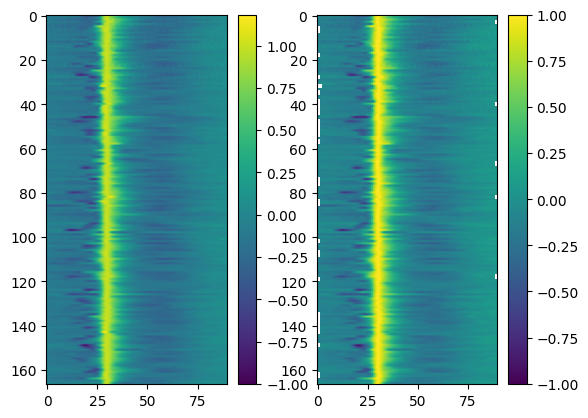

In [444]:
all_wfs = np.array(all_wfs)
all_wfs_aligned = np.array(all_wfs_aligned)
baseline = np.mean(all_wfs[:, :5], axis=1, keepdims=True) 
peaks = np.array(all_peaks).reshape(-1, 1) 

# all_wfs_nl = (all_wfs - baseline) / (peaks - baseline)
all_wfs_nl = all_wfs/peaks
all_wfs_aligned_nl = all_wfs_aligned/all_wfs_aligned[:,30].reshape(-1, 1)

ax = plt.subplot(1, 2, 1)
plt.imshow(all_wfs_nl, aspect='auto', cmap='viridis')
plt.colorbar()
ax = plt.subplot(1, 2, 2)
plt.imshow(all_wfs_aligned_nl, aspect='auto', cmap='viridis')
plt.colorbar()

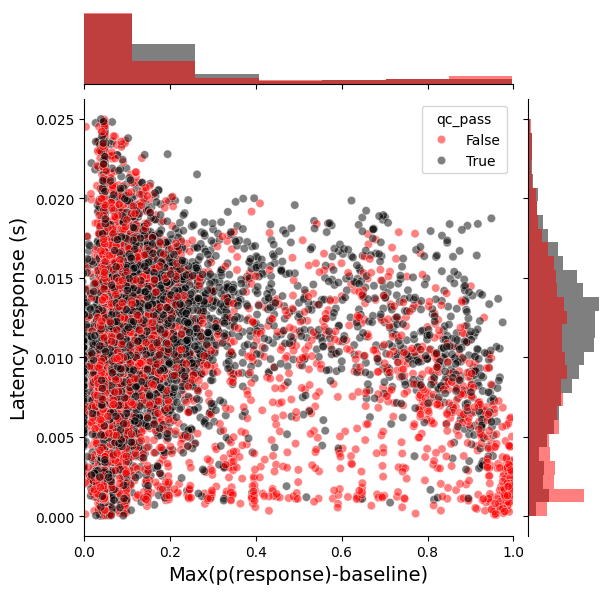

In [315]:
# Define color palette for groups
palette = {True: "k", False: "red"}

# Create JointGrid
g = sns.JointGrid(data=combined_tagged_units, x='p_max', y='lat_max_p', hue='qc_pass', palette=palette)

# Add scatter plot in the center
g.plot_joint(sns.scatterplot, alpha=0.5)
g.ax_joint.set_xlim(0, 1)
g.ax_joint.set_xlabel('Max(p(response)-baseline)', fontsize=14)
g.ax_joint.set_ylabel('Latency response (s)', fontsize=14)

# Add histograms manually for each group
p_max_bins = np.linspace(combined_tagged_units['p_max'].min(), combined_tagged_units['p_max'].max(), 30)
lat_max_p_bins = np.linspace(combined_tagged_units['lat_max_p'].min(), combined_tagged_units['lat_max_p'].max(), 30)
for qc_val, color in palette.items():
    subset = combined_tagged_units[combined_tagged_units['qc_pass'] == qc_val]
    
    # Horizontal histogram for x-axis (default orientation)
    sns.histplot(subset['p_max'], ax=g.ax_marg_x, bins=p_max_bins, color=color, alpha=0.5, edgecolor='none')

    # **VERTICAL histogram for y-axis** using orientation="horizontal"
    sns.histplot(y=subset['lat_max_p'], ax=g.ax_marg_y, bins=lat_max_p_bins, color=color, alpha=0.5, edgecolor='none')


# Show plot
plt.show()


In [445]:
# pca for waveform
# Perform PCA on the waveforms
# amp_thresh = -50
# wf_mat = zscore(all_wfs_nl[np.array(all_peaks)<amp_thresh], axis=0, nan_policy='omit')  # z-score normalize the waveforms
# wf_mat = np.delete(wf_mat, 30, axis=1)
# plt.imshow(wf_mat, aspect='auto', cmap='viridis')
# plt.colorbar(label='Normalized Amplitude')
all_wfs_nl_clean = all_wfs_nl[~np.isnan(all_wfs_nl[:,0])]


In [390]:
pca = PCA(n_components=8)
pc_time = (np.arange(90) - 30)/30000 * 1000  # assuming 90 samples in the waveform
pca_result = pca.fit_transform(all_wfs_nl_clean)
explained_variance = pca.explained_variance_ratio_
coeff = pca.components_
mean = pca.mean_
all_wfs_pc = pca.inverse_transform(pca_result)

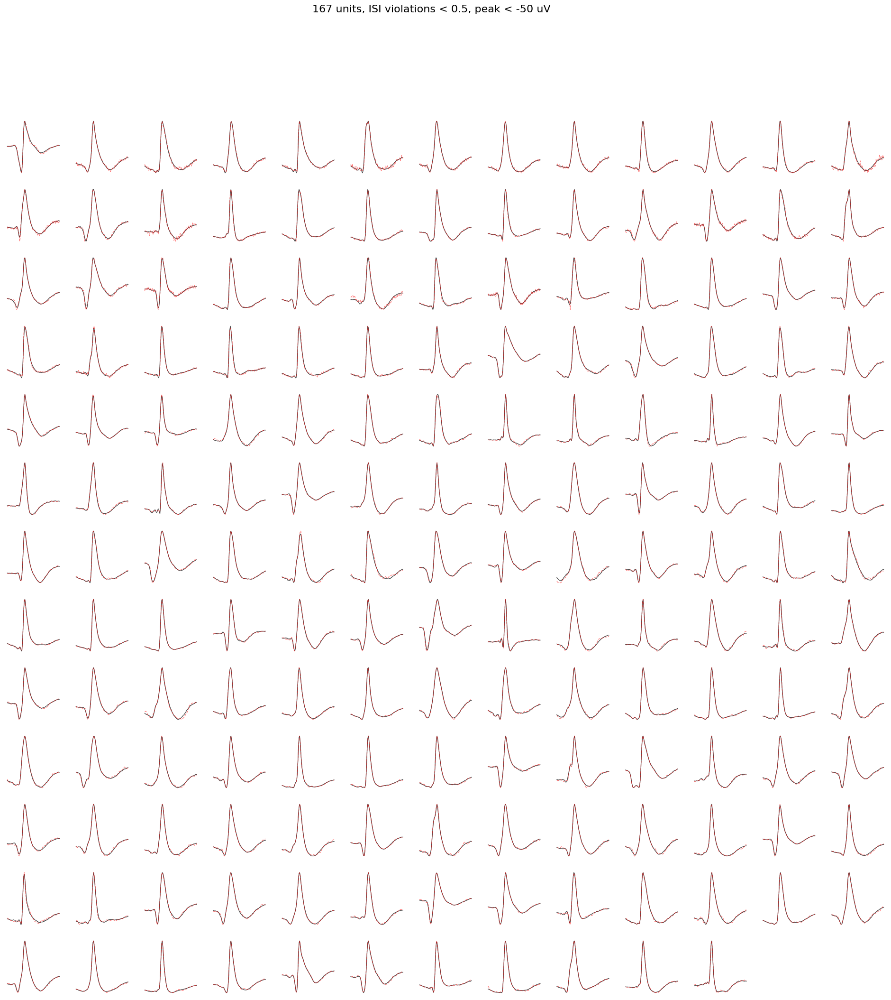

In [358]:
fig = plt.figure(figsize=(24, 24))
gs = gridspec.GridSpec(int(np.ceil(np.sqrt(len(all_wfs_nl_clean)))), int(np.ceil(np.sqrt(len(all_wfs_nl_clean)))), figure=fig)
for i in range(len(all_wfs_nl_clean)):
    ax = fig.add_subplot(gs[i])
    plt.plot(pc_time, all_wfs_pc[i], alpha=0.7, color='k', linewidth=1);
    plt.plot(pc_time, all_wfs_nl_clean[i], color='r', alpha=0.5, linestyle='--', linewidth=1)
    # turn off the axis
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)    
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.suptitle(title, fontsize=16)
plt.savefig(fname=os.path.join(wf_folder, f'All-wf_{criteria_name}.pdf'))


Explained variance ratios: [0.40663959 0.29607455 0.08366661 0.07191005 0.03240982]


Text(0.5, 1.0, 'Explained Variance by PCA Components')

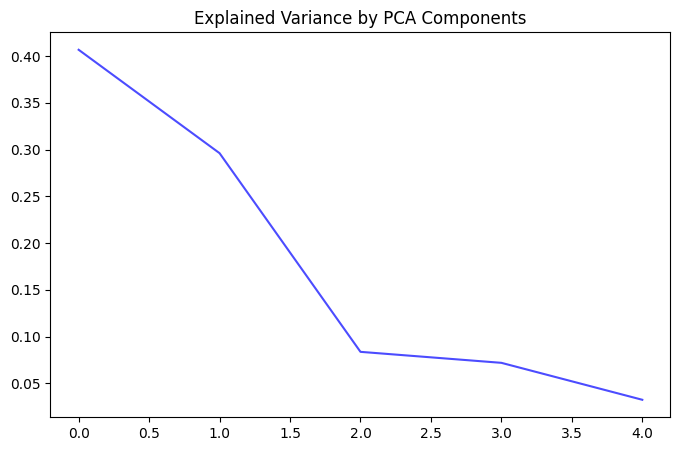

In [446]:
# perform PCA
wf_mat = all_wfs_aligned_nl.copy()
wf_mat = wf_mat[:, 2:-2]
# wf_mat = zscore(all_wfs_nl_clean, axis=0)  # z-score normalize the waveforms
# wf_mat = np.delete(wf_mat, 20, axis=1)  # remove the peak sample to avoid bias in PCA
pca = PCA(n_components=5)  # we can choose the number of components we want
pca_result = pca.fit_transform(wf_mat)
explained_variance = pca.explained_variance_ratio_
print(f'Explained variance ratios: {explained_variance}')
# Plot the explained variance
plt.figure(figsize=(8, 5))
plt.plot(explained_variance, alpha=0.7, color='blue')
plt.title('Explained Variance by PCA Components')

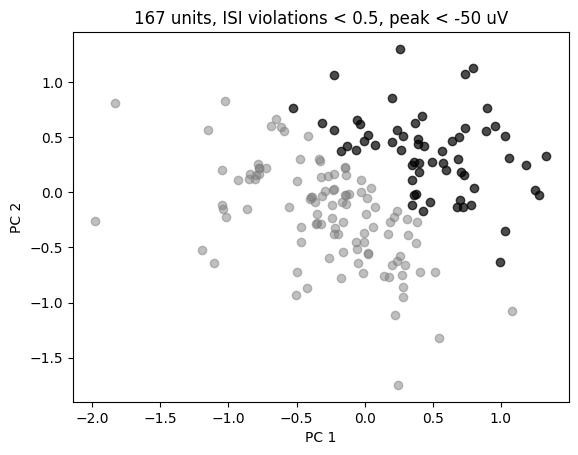

In [447]:
# score = 0.2*pca_result[:, 0] + pca_result[:, 1]
# score = pca_result[:, 0]
score = pca_result[:, 0] + pca_result[:, 1]
# score = pca_result[:, 0] + pca_result[:, 2]
filter = score > 0.15
pc1 = 0
pc2 = 1
plt.scatter(pca_result[filter, pc1], pca_result[filter, pc2], c = 'k', alpha=0.7)
plt.scatter(pca_result[~filter, pc1], pca_result[~filter, pc2], c = 'gray', alpha=0.5)
plt.xlabel('PC 1')
plt.ylabel('PC 2')
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.title(title)
plt.savefig(fname=os.path.join(wf_folder, f'pca_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

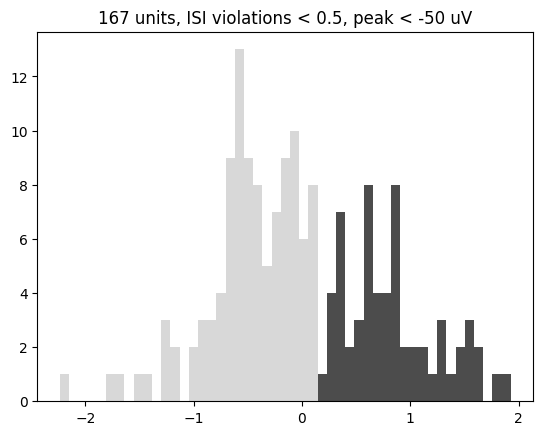

In [393]:
bins = np.linspace(np.min(score), np.max(score), 50)
plt.hist(score[filter], bins=bins, color='k', alpha=0.7);
plt.hist(score[~filter], bins=bins, color='gray', alpha=0.3);
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.title(title)
plt.savefig(fname=os.path.join(wf_folder, f'Projection_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

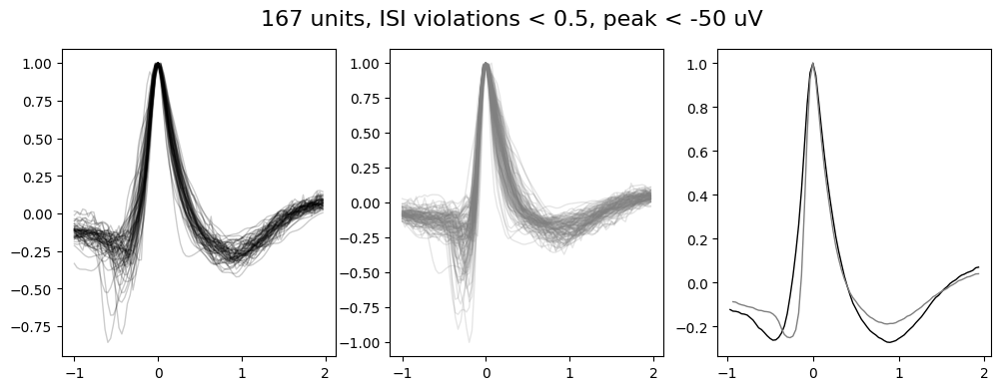

In [394]:
fig = plt.figure(figsize=(12, 4))
wf_time = (np.arange(90) - 30)/30000 * 1000  # assuming 90 samples in the waveform
plt.subplot(1, 3, 1)
plt.plot(wf_time, all_wfs_aligned_nl[filter].T, alpha=0.2, linewidth=1, color='k');
plt.subplot(1, 3, 2)
plt.plot(wf_time, all_wfs_aligned_nl[~filter].T, alpha=0.2, linewidth=1, color=[0.5, 0.5, 0.5]);  # plot the ones with higher pca values in black
plt.subplot(1, 3, 3)
plt.plot(wf_time, np.mean(all_wfs_aligned_nl[filter], axis=0), linewidth=1, color='k');  # plot the ones with higher pca values in black
plt.plot(wf_time, np.mean(all_wfs_aligned_nl[~filter], axis=0), linewidth=1, color=[0.5, 0.5, 0.5]);
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.suptitle(title, fontsize=16)
plt.savefig(fname=os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

193

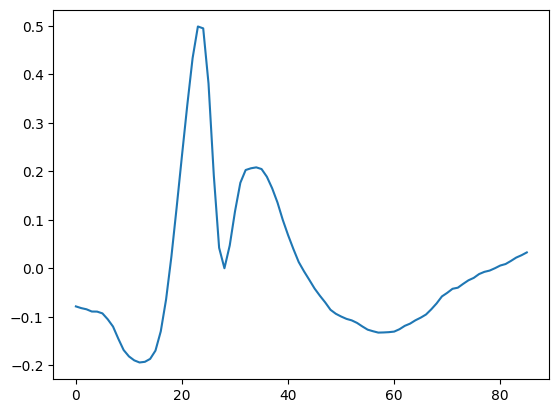

In [328]:
plt.plot(pca.components_[0] + pca.components_[1])
len(score)

In [451]:
# save waveform features
wf_features['score'] = score
wf_features['pc1'] = pca_result[:, 0]
wf_features['pc2'] = pca_result[:, 1]
wf_features['wf'] = all_wfs_aligned_nl.tolist()
# save to pickle 
with open(os.path.join(wf_folder, 'wf_features.pkl'), 'wb') as f:
    pickle.dump(wf_features, f)

Not enough units for session: ecephys_713854_2024-03-05_12-01-40
Not enough units for session: ecephys_713854_2024-03-05_13-31-20
Not enough units for session: behavior_716325_2024-05-31_10-31-14
Not enough units for session: behavior_717121_2024-06-15_10-00-58
Not enough units for session: behavior_751004_2024-12-19_11-50-37
Not enough units for session: behavior_751004_2024-12-22_13-09-17
Not enough units for session: behavior_751769_2025-01-16_11-32-05
Not enough units for session: behavior_758017_2025-02-05_11-42-34
Not enough units for session: behavior_751181_2025-02-25_12-12-35
Not enough units for session: behavior_754897_2025-03-11_12-07-41
Not enough units for session: behavior_754897_2025-03-12_12-23-15
Not enough units for session: behavior_754897_2025-03-14_11-28-53


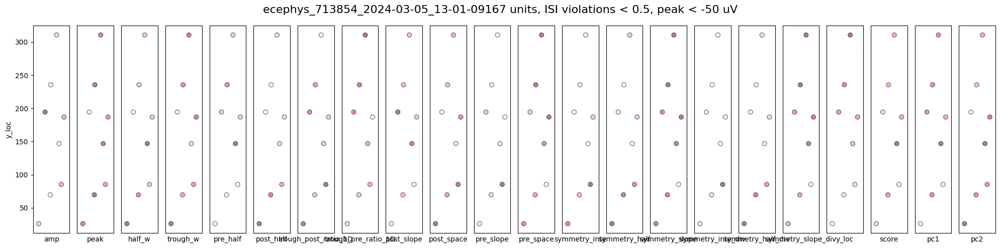

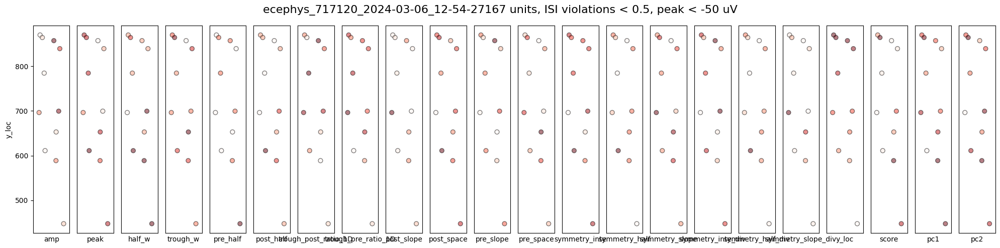

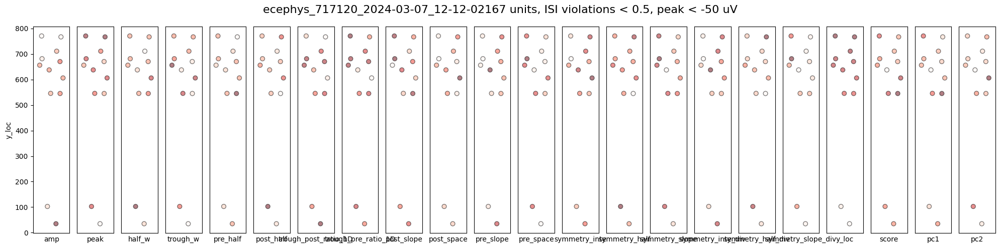

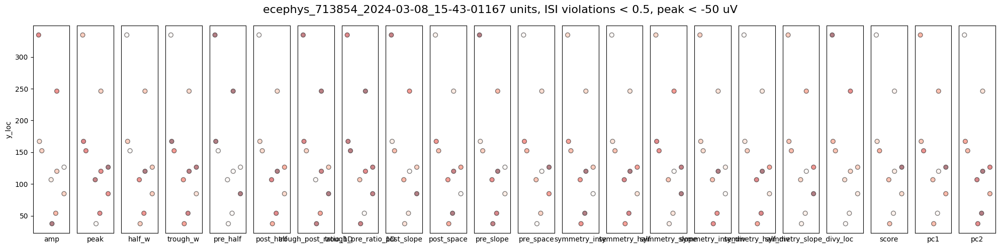

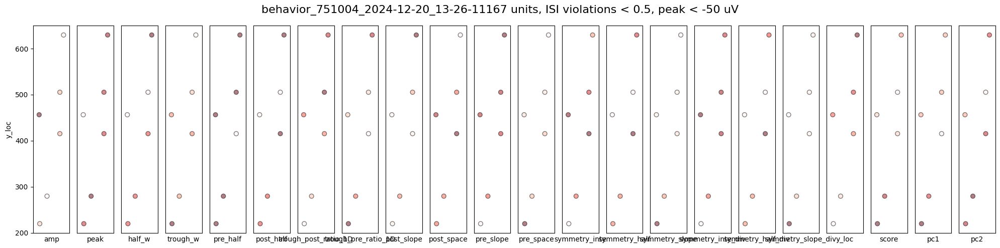

...

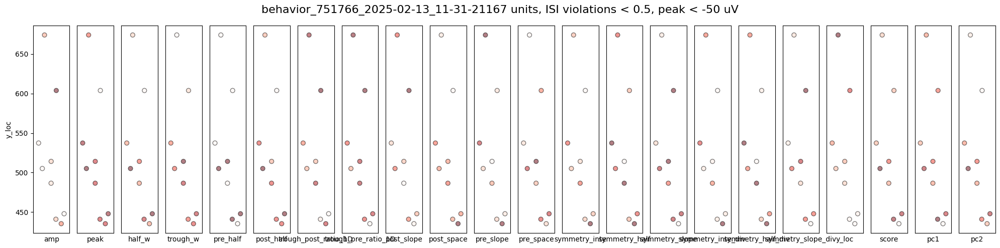

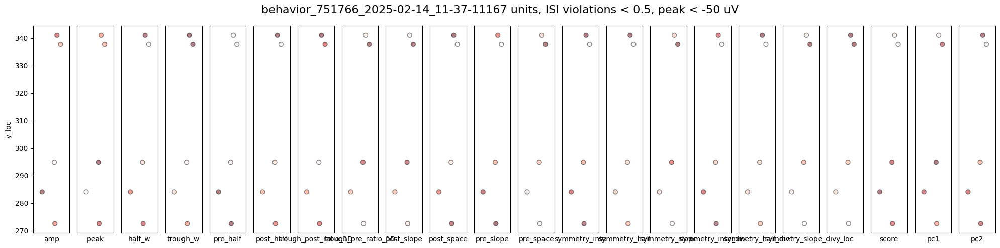

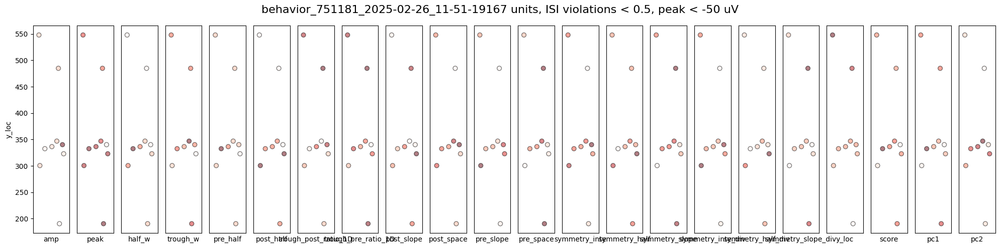

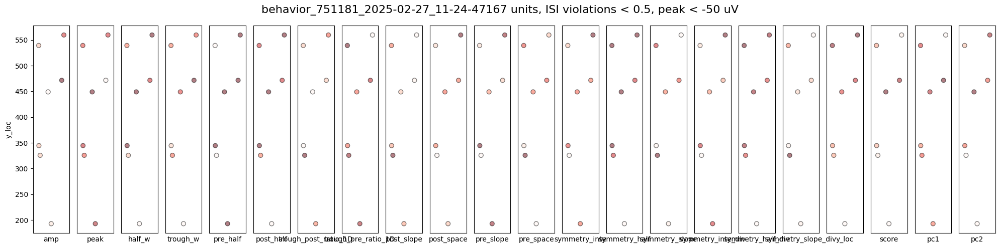

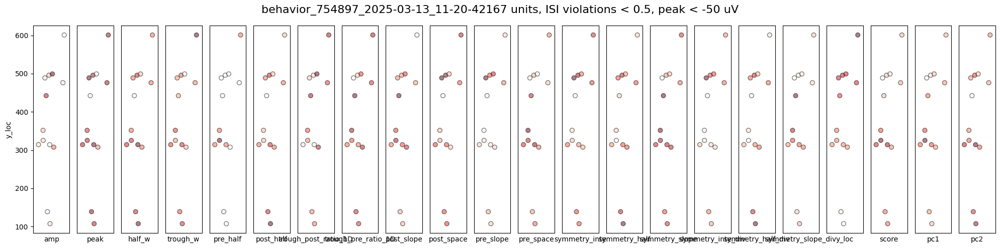

In [236]:
features = wf_features.columns.tolist()
features.remove('probe')
features.remove('session')
features.remove('unit_id')
ncols = len(features)
sessions = combined_tagged_units_filtered['session'].unique()
for session in sessions:
    session_combined_tagged_units_filtered = combined_tagged_units_filtered[combined_tagged_units_filtered['session'] == session].reset_index(drop=True)
    session_wf_features = wf_features[combined_tagged_units_filtered['session'] == session].reset_index(drop=True)
    if len(session_combined_tagged_units_filtered) < 5:
        print('Not enough units for session:', session)
        continue
    fig_feature, axes_f = plt.subplots(1, ncols=ncols, figsize=(20, 5))
    x = np.random.rand(len(session_combined_tagged_units_filtered))
    for f_ind, feature in enumerate(features):
        if feature not in wf_features.columns:
            continue
        # scatter plot by y_loc, color coded by feature, with color bar
        focus = session_wf_features[feature].values
        # random number for x
        axes_f[f_ind].scatter(x, session_wf_features['y_loc'], c=focus, cmap='Reds', s=40, edgecolor='black', alpha=0.5)
        axes_f[f_ind].set_xlabel(feature)
        if f_ind == 0:
            axes_f[f_ind].set_ylabel('y_loc')
        else:
            axes_f[f_ind].yaxis.set_ticks([])
        axes_f[f_ind].set_xlim(np.min(x)-0.2, np.max(x)+0.2)
        # turn off axis
        # for spine in ['top', 'bottom', 'left', 'right']:
        #     axes_f[f_ind].spines[spine].set_visible(False)
        # turn off x axis ticks
        axes_f[f_ind].xaxis.set_ticks([])

    title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
    plt.suptitle(session+title, fontsize=16)
    plt.tight_layout()
    plt.savefig(fname=os.path.join(wf_folder, f'{session}_all_feature_{criteria_name}.png'), dpi=300, bbox_inches='tight')

    # reordered = session_combined_tagged_units_filtered.sort_values(by='y_loc', ascending=False).reset_index(drop=True)
    # fig_wf, axe_wf = plt.subplots(nrows=len(reordered), ncols=1, figsize=(5, 2*len(reordered)))
    # for i, row in reordered.iterrows():
    #     wf = row['wf']
    #     peak = row['peak']
    #     axe_wf[i].plot(wf/np.abs(peak), color='blue')
    #     axe_wf[i].set_title(f'{row["y_loc"]}')
    #     axe_wf[i].axis('off')      
    # fig_wf.tight_layout()
    # fig_wf.savefig(fname=os.path.join('/root/capsule/scratch/combined/wf_plots', f'{session}_wf.png'), dpi=300, bbox_inches='tight')

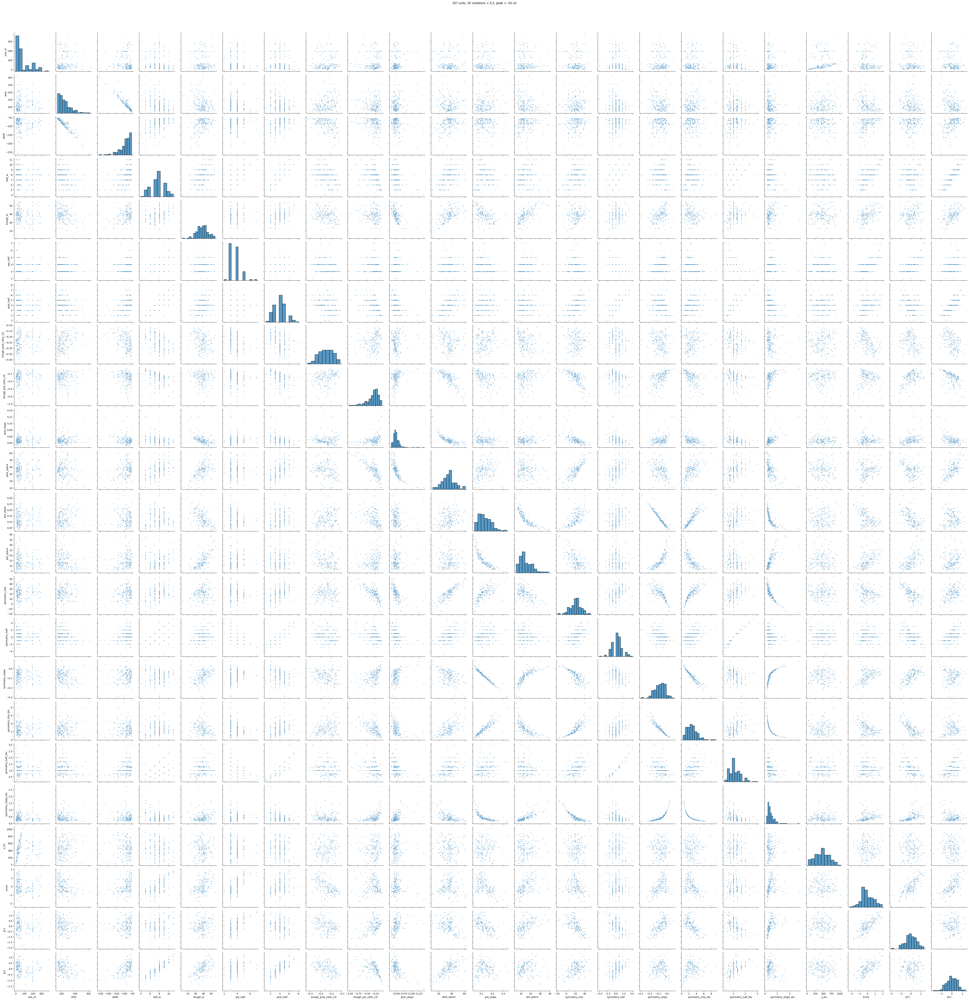

In [237]:
g = sns.pairplot(wf_features, corner=False, 
             plot_kws={'alpha': 0.5, 's': 10},
            #  hue='probe'
             )
# save figure
title = f"{len(wf_features)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
g.fig.suptitle(title, y=1.02)
g.savefig(os.path.join(wf_folder, f'Wf_features_pairplot_{criteria_name}_all.png'), dpi=300)

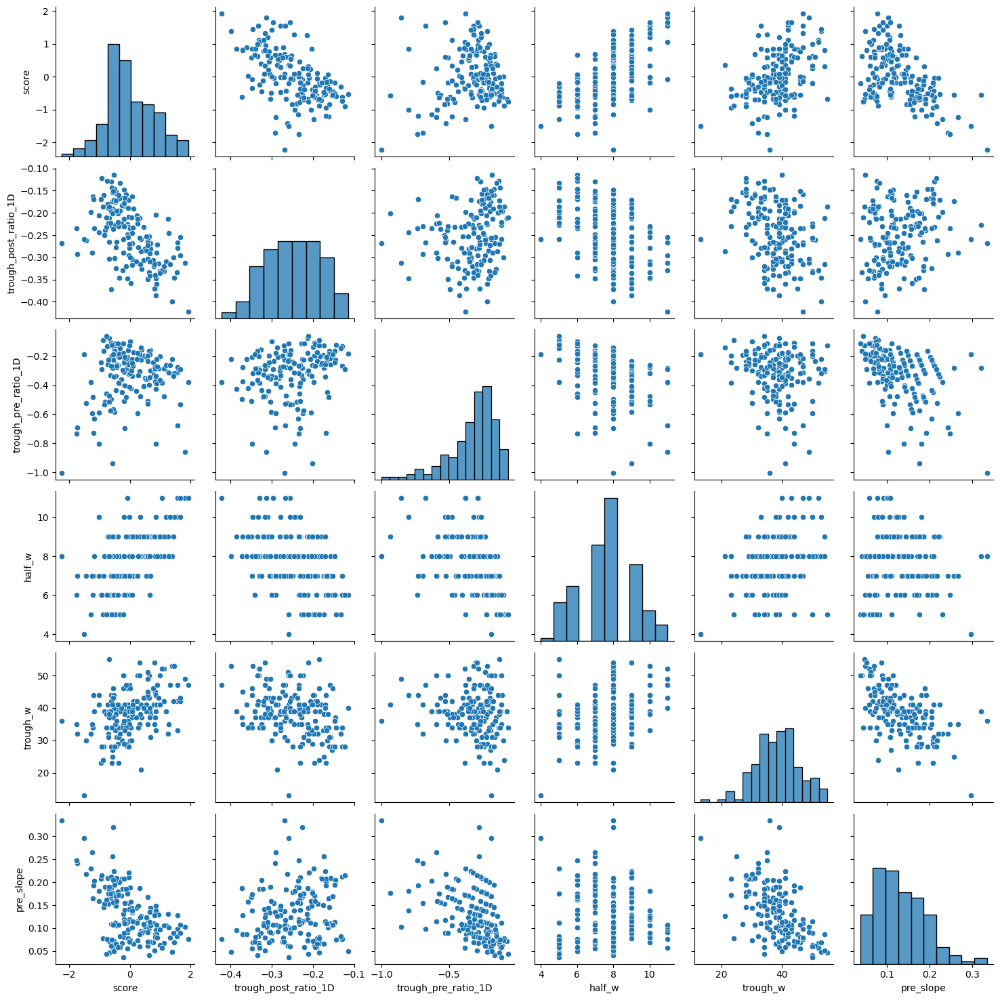

In [238]:
feature = wf_features[['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope']].copy()
g = sns.pairplot(feature, corner=False)

<Figure size 800x600 with 0 Axes>

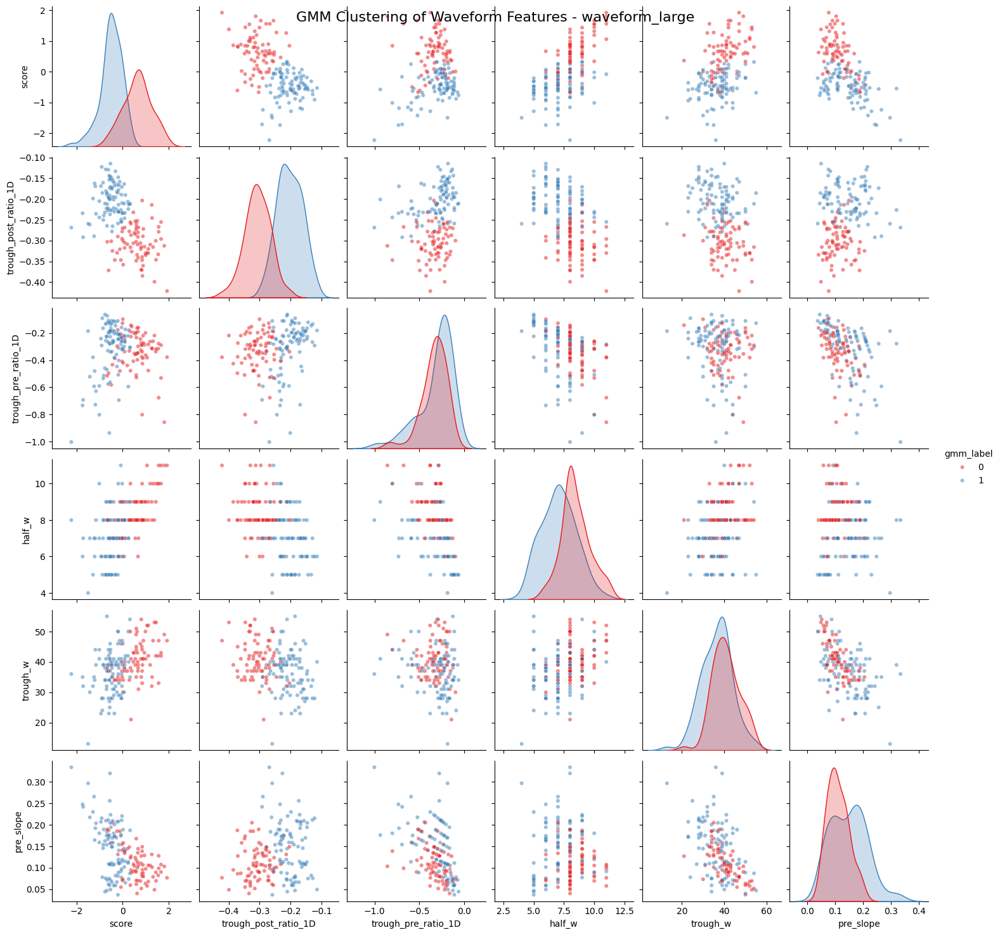

In [239]:
# perform GMM clustering using features from wf_features
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=2, random_state=4)
feature_list = ['score', 'trough_post_ratio_1D']
zscore_feature = zscore(feature[feature_list], axis=0, nan_policy='omit')
gmm.fit(zscore_feature)
feature['gmm_label'] = gmm.predict(zscore_feature)
# plot the GMM clusters
plt.figure(figsize=(8, 6))
g = sns.pairplot(data=feature, hue='gmm_label', vars=['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope'], palette='Set1', plot_kws={'alpha': 0.5, 's': 20})
plt.xlabel('Score')
plt.ylabel('Trough Post Ratio')
plt.suptitle(f'GMM Clustering of Waveform Features - {criteria_name}', fontsize=16)
# save the GMM model
plt.savefig(os.path.join(wf_folder, f'GMM_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')
# save feature with gmm cluestering applied
wf_features['gmm_label'] = feature['gmm_label']
wf_features['gmm_conf'] = np.max(gmm.predict_proba(zscore_feature), axis = 1)
wf_features.to_csv(os.path.join(wf_folder, 'wf_features.csv'), index=False)


<Figure size 800x600 with 0 Axes>

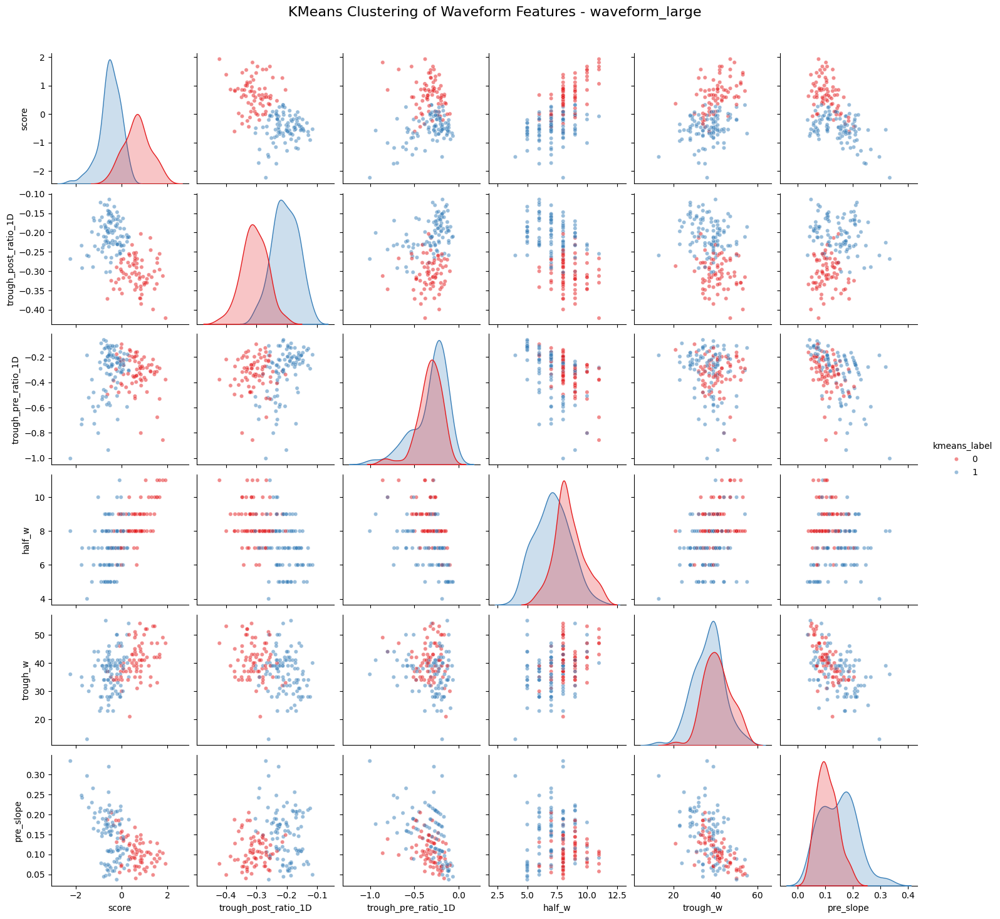

In [240]:
from sklearn.cluster import KMeans

# Perform KMeans clustering using features from wf_features
kmeans = KMeans(n_clusters=2, random_state=4, n_init='auto')  # Adjust n_init for sklearn >= 1.2
feature_list = ['score', 'trough_post_ratio_1D']
zscore_feature = zscore(feature[feature_list], axis=0, nan_policy='omit')

# Fit KMeans and assign cluster labels
kmeans.fit(zscore_feature)
feature['kmeans_label'] = kmeans.labels_

# Plot the KMeans clusters
plt.figure(figsize=(8, 6))
g = sns.pairplot(
    data=feature,
    hue='kmeans_label',
    vars=['score', 'trough_post_ratio_1D', 'trough_pre_ratio_1D', 'half_w', 'trough_w', 'pre_slope'],
    palette='Set1',
    plot_kws={'alpha': 0.5, 's': 20}
)

# Add title and save plots
plt.suptitle(f'KMeans Clustering of Waveform Features - {criteria_name}', fontsize=16)
g.fig.subplots_adjust(top=0.93)  # Adjust to make room for title

g.savefig(os.path.join(wf_folder, f'KMeans_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

# Save features with KMeans clustering applied
wf_features['kmeans_label'] = feature['kmeans_label']
wf_features.to_csv(os.path.join(wf_folder, 'wf_features.csv'), index=False)


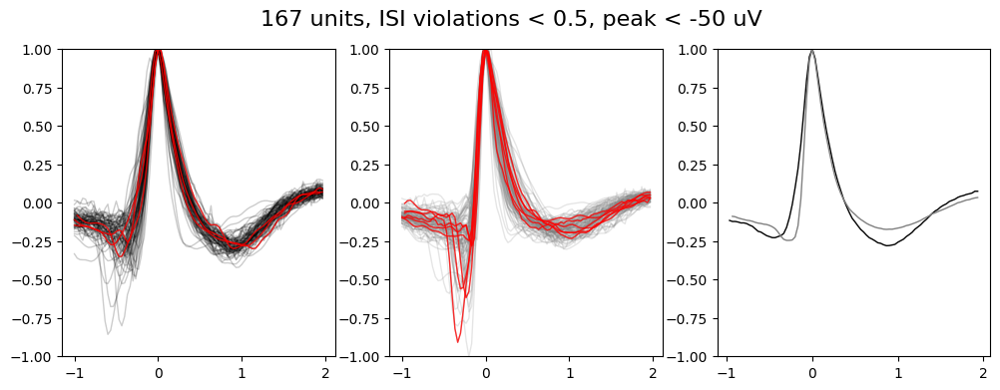

In [241]:
fig = plt.figure(figsize=(12, 4))
wf_time = (np.arange(90) - 30)/30000 * 1000  # assuming 90 samples in the waveform
filter = feature['kmeans_label'] == 0  # filter for the first cluster
plt.subplot(1, 3, 1)
plt.ylim(-1, 1)
plt.plot(wf_time, all_wfs_aligned_nl[filter].T, alpha=0.2, linewidth=1, color='k');
plt.subplot(1, 3, 2)
plt.plot(wf_time, all_wfs_aligned_nl[~filter].T, alpha=0.2, linewidth=1, color=[0.5, 0.5, 0.5]);  # plot the ones with higher pca values in black
plt.ylim(-1, 1)
plt.subplot(1, 3, 3)
plt.ylim(-1, 1)
plt.plot(wf_time, np.mean(all_wfs_aligned_nl[filter], axis=0), linewidth=1, color='k');  # plot the ones with higher pca values in black
plt.plot(wf_time, np.mean(all_wfs_aligned_nl[~filter], axis=0), linewidth=1, color=[0.5, 0.5, 0.5]);
title = f"{len(all_wfs_nl_clean)} units, ISI violations < {constraints['isi_violations']['bounds'][1]}, peak < {constraints['peak']['bounds'][1]} uV"
plt.suptitle(title, fontsize=16)
plt.savefig(fname=os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

if 'anti_resp' in combined_tagged_units_filtered.columns:
    plt.subplot(1, 3, 1)
    plt.plot(wf_time, all_wfs_aligned_nl[filter & (combined_tagged_units_filtered['anti_resp'] == 1) & (wf_features['gmm_conf']>0.9)].T, alpha=0.8, linewidth=1, color='r');
    plt.ylim(-1, 1)
    plt.subplot(1, 3, 2)
    plt.plot(wf_time, all_wfs_aligned_nl[~filter & (combined_tagged_units_filtered['anti_resp'] == 1) & (wf_features['gmm_conf']>0.9)].T, alpha=0.8, linewidth=1, color='r');  # plot the ones with higher pca values in black
    plt.ylim(-1, 1)
plt.savefig(fname=os.path.join(wf_folder, f'Clusters_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

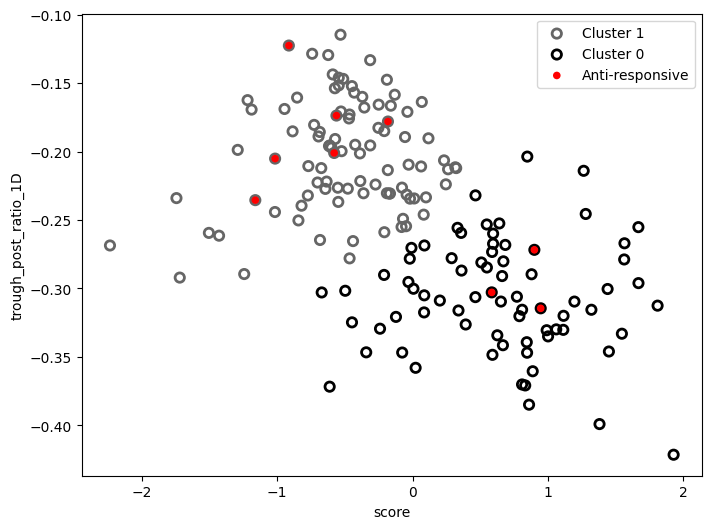

In [242]:
x_feature = 'score'
y_feature = 'trough_post_ratio_1D'
plt.figure(figsize=(8, 6))
colors =  [[0, 0, 0], [0.4, 0.4, 0.4]]
for i, label in enumerate(feature['gmm_label'].unique()):
    subset = feature[feature['gmm_label'] == label]
    plt.scatter(subset[x_feature], subset[y_feature], facecolors='none', label=f'Cluster {label}', edgecolors = colors[label], s = 45, linewidths=2)
if 'anti_resp' in combined_tagged_units_filtered.columns:
    subset = feature[combined_tagged_units_filtered['anti_resp'] == 1 & (wf_features['gmm_conf']>0.9)]
    plt.scatter(subset[x_feature], subset[y_feature], facecolors='red', edgecolors='none', s=30, linewidths=2, label='Anti-responsive')
plt.xlabel(x_feature)
plt.ylabel(y_feature)
plt.legend()
plt.savefig(os.path.join(wf_folder, f'{x_feature}_{y_feature}_gmm_clustering_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

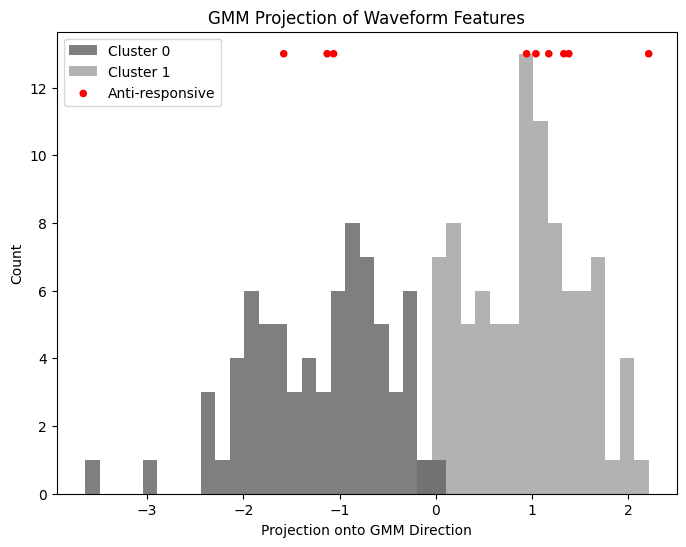

In [243]:
# Compute projection direction: vector between the two GMM means
mean_diff = gmm.means_[1] - gmm.means_[0]
projection_direction = mean_diff / np.linalg.norm(mean_diff)  # Normalize

# Project all points onto that direction
projected_values = zscore_feature @ projection_direction
feature['gmm_projection'] = projected_values

# Plot the projection
plt.figure(figsize=(8, 6))
bins = np.linspace(np.min(projected_values), np.max(projected_values), 40)
plt.hist(projected_values[feature['gmm_label'] == 0], bins=bins, color=colors[0], alpha=0.5, label='Cluster 0')
plt.hist(projected_values[feature['gmm_label'] == 1], bins=bins, color= colors[1], alpha=0.5, label='Cluster 1')
plt.xlabel('Projection onto GMM Direction')
plt.ylabel('Count')
plt.title('GMM Projection of Waveform Features')

# scatter the anti-responsive units
if 'anti_resp' in combined_tagged_units_filtered.columns:
    anti_resp = feature[(combined_tagged_units_filtered['anti_resp'] == 1) & (wf_features['gmm_conf']>0.9)]
    plt.scatter(anti_resp['gmm_projection'], np.zeros_like(anti_resp['gmm_projection'])+13, color='red', label='Anti-responsive', s=30, edgecolors='none')

plt.legend()
plt.savefig(os.path.join(wf_folder, f'GMM_projection_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


KeyError: 'score'

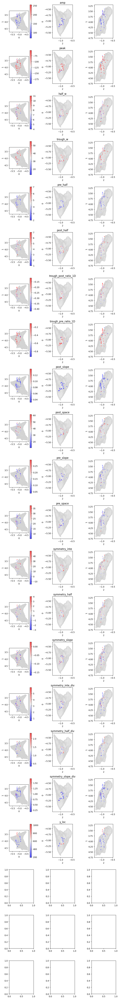

In [395]:
from matplotlib.colors import Normalize
norm = Normalize(vmin=0, vmax=1)

mesh = load_mesh('/root/capsule/scratch/combined/ccf_maps/20250418_transformed_remesh_10_ccf25.obj')
mesh_vertices = np.array(mesh.vertices)
mesh_vertices_mm = ccf_pts_convert_to_mm(mesh_vertices)
mesh_vertices_mm[:, 2] = -np.abs(mesh_vertices_mm[:, 2])  # Mirror ML to left
blue_white_red = LinearSegmentedColormap.from_list(
    'blue_white_red',
    [(0, 'blue'), (0.5, 'white'), (1.0, 'red')]
)
ml, ap, dv = 2, 0, 1
planes = {'sag': [ap, dv], 'hor': [ml, ap], 'cor': [ml, dv]}

fig, axes = plt.subplots(len(features), 3, figsize=(8, 3*len(features)))

for ind, feature in enumerate(features):
    color_code = wf_features[feature].values
    x_ccf = combined_tagged_units_filtered['x_ccf'].values
    y_ccf = combined_tagged_units_filtered['y_ccf'].values
    z_ccf = combined_tagged_units_filtered['z_ccf'].values
    ccfs = np.column_stack((x_ccf, y_ccf, z_ccf))
    ccfs = ccf_pts_convert_to_mm(ccfs)
    ccfs[:, 2] = -np.abs(ccfs[:, 2])  # Mirror ML to left
    for plane, ax in zip(planes.keys(), axes[ind]):
        # Plot the mesh
        ax.scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
        # Plot the points
        sc = ax.scatter(ccfs[:, planes[plane][0]], ccfs[:, planes[plane][1]], c=color_code, cmap=blue_white_red, s=10, edgecolor='none', alpha=0.7)
        if plane == 'hor':
            ax.set_title(feature)
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        # set equal aspect ratio
        ax.set_aspect('equal')
        if planes[plane][1] == dv:
            ax.invert_yaxis()
        if plane == 'sag':
            fig.colorbar(sc, ax=ax)

    plt.tight_layout()


In [245]:


# -----------------------
# Generate synthetic data
# -----------------------
np.random.seed(40)
n_samples = 100
n = n_samples
n_regressors = 10

# True projection direction (unit vector)
v_true = np.random.randn(3)
v_true /= np.linalg.norm(v_true)

# True regressor weights
w_true = np.random.randn(n_regressors)

# Data
X = np.random.randn(n_samples, n_regressors)
y = X @ w_true + 0.1 * np.random.randn(n_samples)  # observed projection

# Step 1: Basis for orthogonal space (null space of v_trueᵗ)
null_basis = null_space(v_true[None, :])  # shape (3, 2)

# Step 2: Random offsets in orthogonal space
rand_coeffs = np.random.randn(n, 2)
orthogonal_offsets = rand_coeffs @ null_basis.T  # shape (n, 3)

# Step 3: True projected component
P_proj = np.outer(y, v_true)  # shape (n, 3)

# Step 4: Final spatial positions
P = P_proj + orthogonal_offsets


In [494]:

# -----------------------
# Optimization target
# -----------------------

def loss_fn(params, P, X, lambda_reg=0):
    v = params[:np.shape(P)[1]]
    w = params[np.shape(P)[1]:]
    proj = P @ v
    pred = X @ w # n unit x p feature @ p feature x 1
    reg_term = lambda_reg * np.mean(np.abs(w))
    cost = -np.corrcoef(proj, pred)[0, 1]
    # cost = np.mean((proj - pred) ** 2)/np.std(proj)

    return cost + reg_term


def loss_fn_fix_v(params, y, X, lambda_reg=0.1):
    pred = X @ params
    reg_term = lambda_reg * np.mean(np.abs(params[1:]))
    # cost = -np.corrcoef(proj, pred)[0, 1]
    cost = np.mean((y - pred) ** 2)/np.std(y)

    return cost + reg_term

def unit_norm_constraint(params):
    v = params[:3]
    return np.dot(v, v) - 1

def map_to_orthogonal_space(X, P, seed = None):
    if seed is not None:
        np.random.seed(seed) 
    constraint = {
        'type': 'eq',
        'fun': unit_norm_constraint
    }

    # Initial guess
    params0 = np.random.randn(np.shape(P)[1] + np.shape(X)[1])
    params0[:np.shape(P)[1]] /= np.linalg.norm(params0[:np.shape(P)[1]])  # unit vector for v

    # -----------------------
    # Minimize the loss
    # -----------------------
    res_corr = minimize(
        loss_fn,
        params0,
        args=(P, X),
        method='SLSQP',
        constraints=[constraint],
        options={'disp': True, 'maxiter': 500}
    )

    v_est = res_corr.x[:np.shape(P)[1]]
    v_est /= np.linalg.norm(v_est)
    w_est_corr = res_corr.x[np.shape(P)[1]:]
    y = P @ v_est

    params0 = np.random.randn(np.shape(X)[1])

    res = minimize(
        loss_fn_fix_v,
        params0,
        args=(y, X),
        method='SLSQP',
        options={'disp': True, 'maxiter': 500}
    )
    w_est = res.x
    # -----------------------
    # Evaluation
    # -----------------------
    print("\n--- Evaluation ---")
    print("Estimated w:", w_est)
    print("Estimated v:", v_est)
    # print("Cosine similarity:", np.dot(v_true, v_est))
    return v_est, w_est, res_corr, res, w_est_corr

# # proj_true = P @ v_true
# proj_true = P @ v_est
# proj_pred = X @ w_est

# plt.figure(figsize=(6, 6))
# plt.scatter(proj_true, proj_pred, alpha=0.5)
# plt.plot([proj_true.min(), proj_true.max()],
#          [proj_true.min(), proj_true.max()], 'r--')
# plt.xlabel("True projection (P @ v_true)")
# plt.ylabel("Predicted projection (X @ w_est)")
# plt.title("True vs Predicted Projection")
# plt.axis("equal")
# plt.grid(True)
# plt.tight_layout()
# plt.show()
def map_to_fixed_orthogonal_space(X, P, seed = None):
    if seed is not None:
        np.random.seed(seed) 
    constraint = {
        'type': 'eq',
        'fun': unit_norm_constraint
    }

    # fixed v from GLM

    v_est = np.array([0.44137469, 0.79373018, -0.41854604]) # projection
    v_est = np.array([0.184134, 0.184929, -0.083746]) # gene expression
    y = P @ v_est

    params0 = np.random.randn(np.shape(X)[1])

    res = minimize(
        loss_fn_fix_v,
        params0,
        args=(y, X),
        method='SLSQP',
        options={'disp': False, 'maxiter': 500}
    )
    w_est = res.x
    # -----------------------
    # Evaluation
    # -----------------------
    print("\n--- Evaluation ---")
    print("Estimated w:", w_est)
    print("Estimated v:", v_est)
    w_est_corr = w_est
    res_corr = res
    # print("Cosine similarity:", np.dot(v_true, v_est))
    return v_est, w_est, res_corr, res, w_est_corr

# # proj_true = P @ v_true
# proj_true = P @ v_est
# proj_pred = X @ w_est

# plt.figure(figsize=(6, 6))
# plt.scatter(proj_true, proj_pred, alpha=0.5)
# plt.plot([proj_true.min(), proj_true.max()],
#          [proj_true.min(), proj_true.max()], 'r--')
# plt.xlabel("True projection (P @ v_true)")
# plt.ylabel("Predicted projection (X @ w_est)")
# plt.title("True vs Predicted Projection")
# plt.axis("equal")
# plt.grid(True)
# plt.tight_layout()
# plt.show()

## Data

In [397]:
x_ccf = combined_tagged_units_filtered['x_ccf'].values
y_ccf = combined_tagged_units_filtered['y_ccf'].values
z_ccf = combined_tagged_units_filtered['z_ccf'].values
ccfs = np.column_stack((x_ccf, y_ccf, z_ccf))
ccfs = ccf_pts_convert_to_mm(ccfs)
ccfs[:, 2] = -np.abs(ccfs[:, 2])  # Mirror ML to left
P = ccfs
mask = ~np.isnan(P).any(axis=1)
useless_cols = ['unit_id', 'session', 'amp', 'peak', 'y_loc', 'probe','score', 'gmm_label', 'gmm_conf', 'kmeans_label', 'wf']
too_small_cols = ['pre_half', 'symmetry_inte', 'symmetry_slope', 'pc1', 'pc2', 'post_half']
col_remove = list(set(useless_cols + too_small_cols) & set(wf_features.columns.tolist()))
X_features = wf_features.drop(columns=col_remove).copy()
feature_list = X_features.columns.tolist()
X_features = X_features.values
# append intercept to features
feature_list = ['intercept'] + feature_list
X_features_zs = zscore(X_features[mask], axis=0, nan_policy='omit')
X_features_zs = np.column_stack((np.ones(X_features_zs.shape[0]), X_features_zs))
 

In [398]:
len(combined_tagged_units_filtered)

167

## Bootstrapping

In [40]:
# Function to run one bootstrap iteration
def run_bootstrap_iteration(ind_b, X_features_zs, P, mask, rand_num):
    v_est = []
    w_est = []
    res = []
    res_corr = []
    w_est_corr = []

    idx = np.random.choice(len(X_features_zs), size=len(X_features_zs), replace=True)
    X_sample = X_features_zs[idx]
    P_sample = P[mask][idx]

    for seed in range(rand_num):
        v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_orthogonal_space(
            X_sample, P_sample, seed=seed
        )
        v_est.append(v_est_curr)
        w_est.append(w_est_curr)
        res.append(res_curr)
        res_corr.append(res_corr_curr)
        w_est_corr.append(w_est_corr_curr)

    corr = np.array([-res_corr[ind].fun for ind in range(len(res_corr))])
    best_ind = np.argmax(corr)

    return (
        v_est[best_ind],
        w_est[best_ind],
        res[best_ind],
        res_corr[best_ind],
        w_est_corr[best_ind]
    )

# Parameters
n_bootstrap = 200
rand_num = 100

# Run in parallel
results = Parallel(n_jobs=-1, verbose=1)(
    delayed(run_bootstrap_iteration)(ind_b, X_features_zs, P, mask, rand_num)
    for ind_b in range(n_bootstrap)
)

# Unpack results
v_est_opt, w_est_opt, res_opt, res_corr_opt, w_est_corr_opt = map(np.array, zip(*results))


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.


Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.48862744727611374
            Iterations: 45
            Function evaluations: 784
            Gradient evaluations: 45
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.5298568985394823
            Iterations: 44
            Function evaluations: 762
            Gradient evaluations: 44
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.395114906967835
            Iterations: 37
            Function evaluations: 640
            Gradient evaluations: 37
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.5356040875935304
            Iterations: 50
            Function evaluations: 852
            Gradient evaluations: 50
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.07146383038205593
            Iterations: 29
            Fun

[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:  1.5min


Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.06134223314722065
            Iterations: 27
            Function evaluations: 392
            Gradient evaluations: 27

--- Evaluation ---
Estimated w: [ 3.91758459e-01 -2.56456954e-02  4.45982164e-01 -1.03063654e-01
 -1.46622469e-01  1.62918036e-02 -2.91594052e-01  4.77227027e-02
 -4.34076758e-01  4.19484970e-02  1.11469443e-04 -6.61559704e-02
  1.60580663e-01]
Estimated v: [0.21808358 0.59590699 0.77287412]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.06589600044137217
            Iterations: 24
            Function evaluations: 347
            Gradient evaluations: 24

--- Evaluation ---
Estimated w: [ 0.00712995  0.02807083 -0.49333464  0.11424699  0.1618954  -0.01079974
  0.32226259 -0.05957297  0.4851202  -0.04121308  0.00799847  0.06746196
 -0.18495022]
Estimated v: [-0.32566411 -0.62030031 -0.71356178]
Optimization terminated successfully  

[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:  8.7min


Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6160925670652265
            Iterations: 48
            Function evaluations: 816
            Gradient evaluations: 48
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6751668015917242
            Iterations: 93
            Function evaluations: 1605
            Gradient evaluations: 93
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.08460535607551532
            Iterations: 27
            Function evaluations: 387
            Gradient evaluations: 27

--- Evaluation ---
Estimated w: [-0.63718226 -0.03610129  0.7715392  -0.15939329 -0.26445162  0.01659454
 -0.55008919  0.07802993 -0.71238369  0.05557616 -0.01373559 -0.08340641
  0.23719903]
Estimated v: [0.63034413 0.74036686 0.23350201]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.08460099579505681
            

[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:  9.9min finished


In [248]:
# flip signs relative to dv dim of v_est_opt
# w_corr = np.array([np.corrcoef(w_est[1:], w_est_corr[2:])[0, 1] for i in range(len(res_corr))])
v_est_flip, w_est_flip = zip(*[(v * np.sign(v[dv]), w * np.sign(v[dv])) for v, w in zip(v_est_opt, w_est_opt)])
v_est_flip = np.array(v_est_flip)
w_est_flip = np.array(w_est_flip)

IndexError: invalid index to scalar variable.

In [43]:
w_mean = np.mean(w_est_flip, axis=0)
v_mean = np.mean(v_est_flip, axis=0)
w_se = np.std(w_est_flip, axis=0)
v_se = np.std(v_est_flip, axis=0)

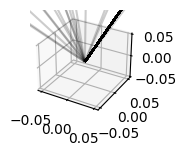

In [44]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est_flip.shape[0]), np.zeros(v_est_flip.shape[0]), np.zeros(v_est_flip.shape[0]),
            v_est_flip[:, ml], v_est_flip[:, ap], v_est_flip[:, dv], color='k', alpha=0.2)

In [81]:
ml, ap, dv

(2, 0, 1)

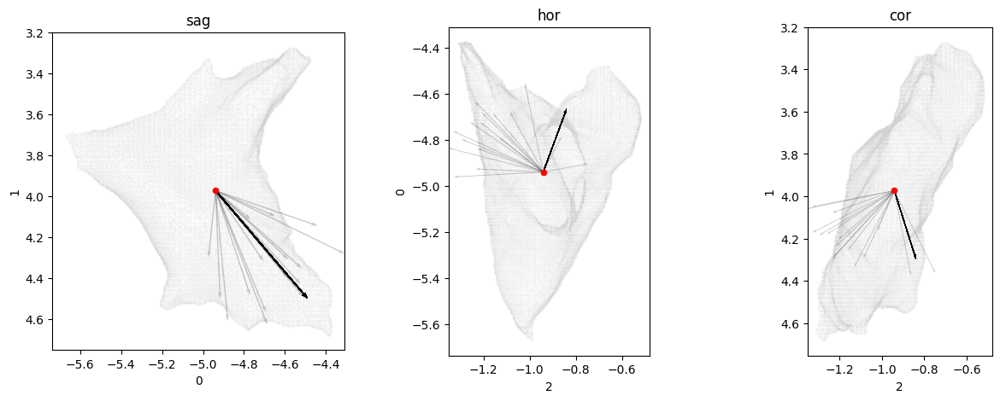

In [45]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
midpoints = np.mean(mesh_vertices_mm, axis=0)

for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)

    if planes[plane][1] == dv:
        axes[ind].quiver(midpoints[planes[plane][0]]*np.ones(n_bootstrap), midpoints[planes[plane][1]]*np.ones(n_bootstrap),
                        v_est_flip[:, planes[plane][0]], -v_est_flip[:, planes[plane][1]], color = 'k', alpha=0.2, scale = 2)
    else:
        axes[ind].quiver(midpoints[planes[plane][0]]*np.ones(n_bootstrap), midpoints[planes[plane][1]]*np.ones(n_bootstrap),
                        v_est_flip[:, planes[plane][0]], v_est_flip[:, planes[plane][1]], color = 'k', alpha=0.2, scale = 2)

    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
plt.savefig(fname=os.path.join(wf_folder, 'bs_v_2D.png'))

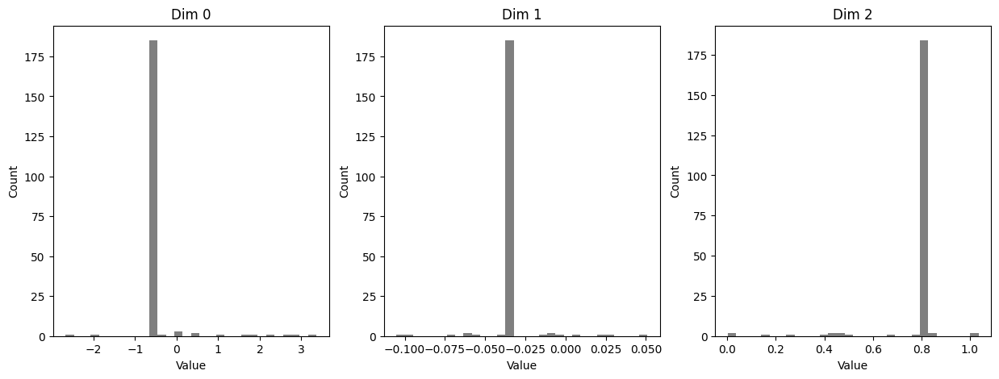

In [69]:
# histo of w_est_flip
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for ind in range(3):
    axes[ind].hist(w_est_flip[:, ind], bins=30, color='k', alpha=0.5)
    axes[ind].set_title(f'Dim {ind}')
    axes[ind].set_xlabel('Value')
    axes[ind].set_ylabel('Count')


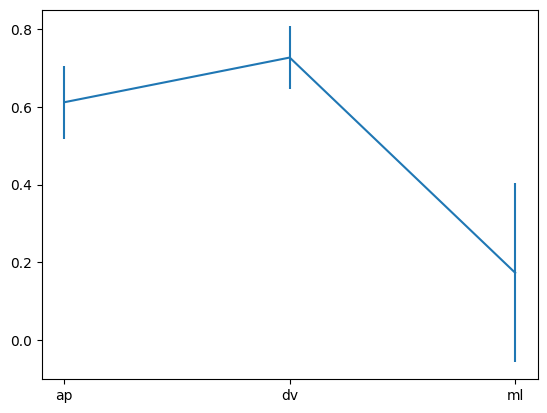

In [73]:
plt.errorbar(range(3), v_mean, yerr=v_se)
plt.xticks(ticks=range(3), labels=['ap', 'dv', 'ml'])

plt.savefig(fname=os.path.join(wf_folder, 'bs_v_errorbar.png'))

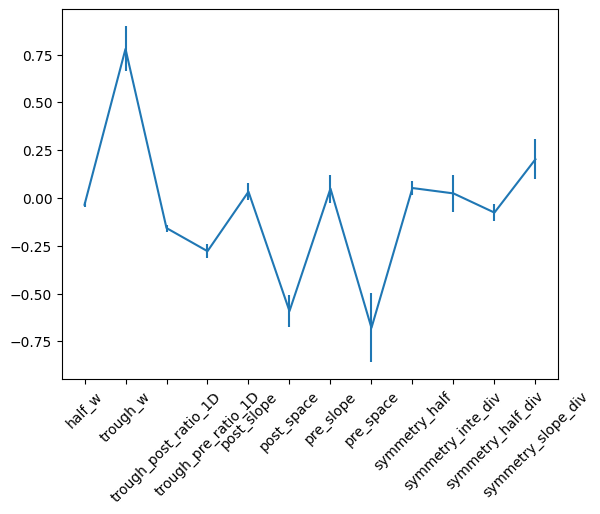

In [75]:
plt.errorbar(range(len(w_mean)-1), w_mean[1:], yerr = w_se[1:])
plt.xticks(ticks=range(len(w_mean)-1), labels=feature_list[1:], rotation = 45)
plt.savefig(fname=os.path.join(wf_folder, 'bs_w_errorbar.png'))

## Whole sample random seeds

In [399]:
# P[mask] = zscore(P[mask], axis=0, nan_policy='omit')
v_est = []
w_est = []
res = []
res_corr = []
w_est_corr = []
for ind, seed in enumerate(range(100)):
    v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_orthogonal_space(X_features_zs, P[mask], seed=seed)
    v_est.append(v_est_curr)
    w_est.append(w_est_curr)
    res.append(res_curr)
    res_corr.append(res_corr_curr)
    w_est_corr.append(w_est_corr_curr)

Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6102111038487512
            Iterations: 84
            Function evaluations: 1442
            Gradient evaluations: 84
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.126983296597061
            Iterations: 19
            Function evaluations: 282
            Gradient evaluations: 19

--- Evaluation ---
Estimated w: [-2.58719387e-01  1.85539576e-02 -2.99677593e-01  8.68407906e-02
  1.21465795e-01 -5.15472160e-02  3.28110510e-01  9.03840404e-05
  1.13101515e-01 -1.81811448e-02 -1.25108649e-01  2.55016159e-02
  2.13035039e-03]
Estimated v: [-0.53968221 -0.64932607  0.53583465]
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.6102110954803176
            Iterations: 93
            Function evaluations: 1589
            Gradient evaluations: 93
Optimization terminated successfully    (Exit mode 0)
            C

# Whole sample with fix v_est

In [400]:
v_est = []
w_est = []
res = []
res_corr = []
w_est_corr = []
for ind, seed in enumerate(range(500)):
    v_est_curr, w_est_curr, res_corr_curr, res_curr, w_est_corr_curr = map_to_fixed_orthogonal_space(X_features_zs, P[mask], seed=seed)
    v_est.append(v_est_curr)
    w_est.append(w_est_curr)
    res.append(res_curr)
    res_corr.append(res_corr_curr)
    w_est_corr.append(w_est_corr_curr)


--- Evaluation ---
Estimated w: [ 1.20129964e+00 -2.17286433e-02  3.38326912e-01 -9.93382700e-02
 -1.34723605e-01  6.49466102e-02 -3.70521270e-01 -3.99912678e-04
 -1.13073709e-01  3.02978970e-02  1.49026444e-01 -4.01480959e-02
 -1.22999843e-02]
Estimated v: [ 0.44137469  0.79373018 -0.41854604]

--- Evaluation ---
Estimated w: [ 1.20126741e+00 -2.23136033e-02  3.37165077e-01 -9.97328577e-02
 -1.34284743e-01  6.44079970e-02 -3.67811753e-01 -1.85097941e-04
 -1.15199285e-01  2.67148625e-02  1.46104281e-01 -3.61573038e-02
 -1.11257767e-02]
Estimated v: [ 0.44137469  0.79373018 -0.41854604]

--- Evaluation ---
Estimated w: [ 1.20126519e+00 -2.24186421e-02  3.34574546e-01 -9.94966704e-02
 -1.33039332e-01  6.43145704e-02 -3.65506546e-01  3.86509494e-05
 -1.12718028e-01  2.66955918e-02  1.45972944e-01 -3.61293814e-02
 -1.18233456e-02]
Estimated v: [ 0.44137469  0.79373018 -0.41854604]

--- Evaluation ---
Estimated w: [ 1.20127327e+00 -2.23341671e-02  3.35160692e-01 -9.97742329e-02
 -1.3313258

In [401]:
# distribution of v_est, flipped by the sign of the dv dimenstion
corr_max = np.array([-res_corr[i].fun for i in range(len(res_corr))])
dis_min = np.array([np.mean((X_features_zs @ w_est[i]-P[mask]@v_est[i])**2)/np.std(P[mask]@v_est[i]) for i in range(len(res_corr))])
w_corr = np.array([np.corrcoef(w_est[1:], w_est_corr[2:])[0, 1] for i in range(len(res_corr))])
v_est, w_est, w_est_corr = zip(*[(v * np.sign(v[dv]), w * np.sign(v[dv]), w_corr * np.sign(v[dv])) for v, w, w_corr in zip(v_est, w_est, w_est_corr)])
v_est = np.array(v_est)
w_est = np.array(w_est)
w_est_corr = np.array(w_est_corr)

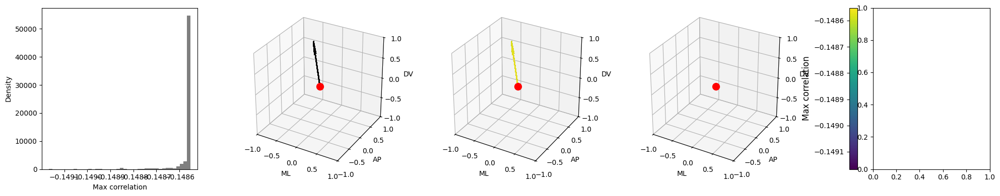

In [402]:
# max_corr
corr_cutoff = 0.45
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable
fig = plt.figure(figsize=(20, 4))
ax = fig.add_subplot(151)
ax.hist(corr_max, bins=40, color='k', alpha=0.5, density=True)
ax.set_xlabel('Max correlation')
ax.set_ylabel('Density')
# colorcode based on corr_max
colormap = plt.cm.viridis
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')

ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]),
            v_est[:, ml], v_est[:, ap], v_est[:, dv], length=1, normalize=True, color='k', alpha=0.2)
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
# set same aspect ratio
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1

ax = fig.add_subplot(153, projection='3d')
for i in range(len(corr_max)):
    ax.quiver(0, 0, 0,
            v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(154, projection='3d')
for i in range(len(corr_max)):
    if corr_max[i] > corr_cutoff:
        ax.quiver(0, 0, 0,
                v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(155)
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=ax, orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)

plt.tight_layout()

plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

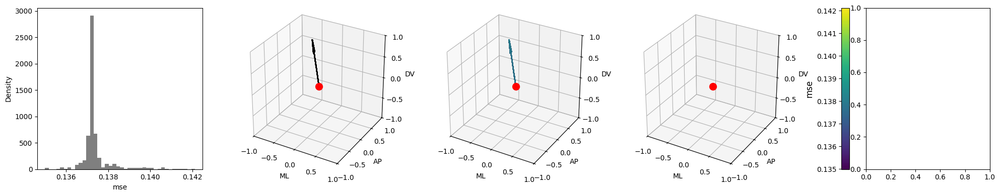

In [403]:
# min_dis
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable
fig = plt.figure(figsize=(20, 4))
ax = fig.add_subplot(151)
ax.hist(dis_min, bins=40, color='k', alpha=0.5, density=True)
ax.set_xlabel('mse')
ax.set_ylabel('Density')
# colorcode based on corr_max
colormap = plt.cm.viridis
norm = Normalize(vmin=np.min(dis_min), vmax=np.max(dis_min))
cmap = plt.cm.viridis
colors_corr = cmap(norm(dis_min))

colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
ax = fig.add_subplot(152, projection='3d')
ax.quiver(np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]), np.zeros(v_est.shape[0]),
            v_est[:, ml], v_est[:, ap], v_est[:, dv], length=1, normalize=True, color='k', alpha=0.2)
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
# set same aspect ratio
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1

ax = fig.add_subplot(153, projection='3d')
for i in range(len(dis_min)):
    ax.quiver(0, 0, 0,
            v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(154, projection='3d')
for i in range(len(dis_min)):
    if dis_min[i] > corr_cutoff:
        ax.quiver(0, 0, 0,
                v_est[i, ml], v_est[i, ap], v_est[i, dv], length=1, normalize=True, color=colors_corr[i], alpha=0.2)
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])
ax.set_xlabel('ML')
ax.set_ylabel('AP')
ax.set_zlabel('DV')
ax.set_box_aspect([1, 1, 1])  # aspect ratio is 1:1:1
ax.scatter(0, 0, 0, color='r', s=100, label='Origin')

ax = fig.add_subplot(155)
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=ax, orientation='vertical', location = 'left')
cbar.set_label('mse', fontsize=12)

plt.tight_layout()

# plt.savefig(os.path.join(wf_folder, f'v_est_dis_color_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

In [404]:

w_est_df = pd.DataFrame(w_est, columns=feature_list)
w_est_df['corr_max'] = corr_max

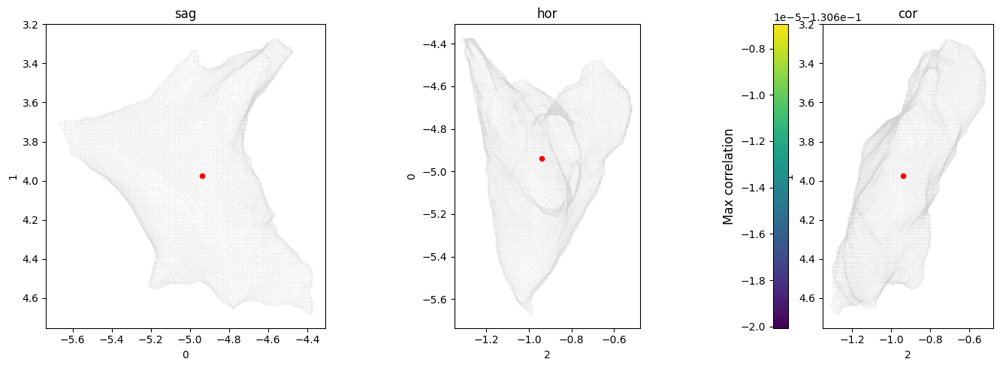

In [ ]:
# plot LC mesh with the vectors
# corr_cutoff = 0
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors
    for i in range(len(corr_max)):
        if corr_max[i] > corr_cutoff:
            if planes[plane][1] == dv:
                axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                                v_est[i, planes[plane][0]]*scale_factor, -v_est[i, planes[plane][1]]*scale_factor, color=colors_corr[i], alpha=0.2, scale = 20)
            else:
                axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                                v_est[i, planes[plane][0]]*scale_factor, v_est[i, planes[plane][1]]*scale_factor, color=colors_corr[i], alpha=0.2, scale = 20)
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_3D_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

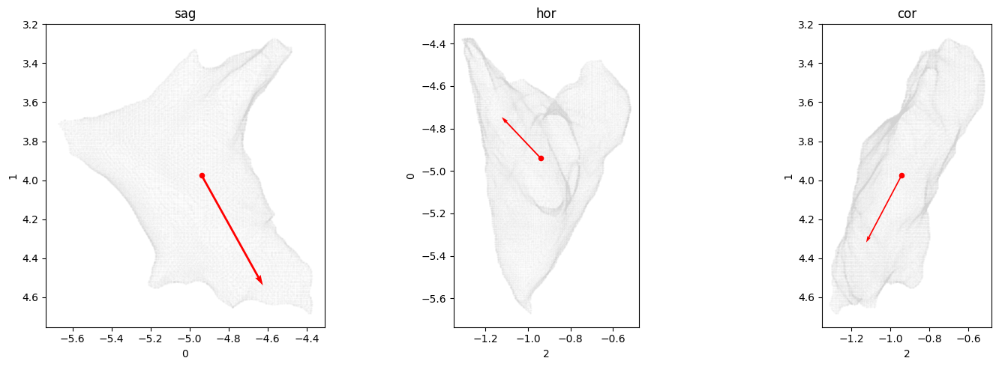

In [405]:
# plot LC mesh with the the fixed vector
# corr_cutoff = 0
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
norm = Normalize(vmin=np.min(corr_max), vmax=np.max(corr_max))
cmap = plt.cm.viridis
colors_corr = cmap(norm(corr_max))
colors_map = cmap(np.arange(0, 1, 0.01))
listed_cmap = ListedColormap(colors_map, name='corr_colors')
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors

    if planes[plane][1] == dv:
        axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est[0, planes[plane][0]], -v_est[0,planes[plane][1]], color='r', alpha=1, scale = 2)
    else:
        axes[ind].quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est[0, planes[plane][0]], v_est[0, planes[plane][1]], color='r', alpha=1, scale = 2)
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
# cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.tight_layout()
plt.savefig(os.path.join(wf_folder, f'v_est_corr_color_3D_{criteria_name}_fixed_v.pdf'), dpi=300, bbox_inches='tight')

In [255]:
v_est[planes[plane][0]]

array([ 0.44137469,  0.79373018, -0.41854604])

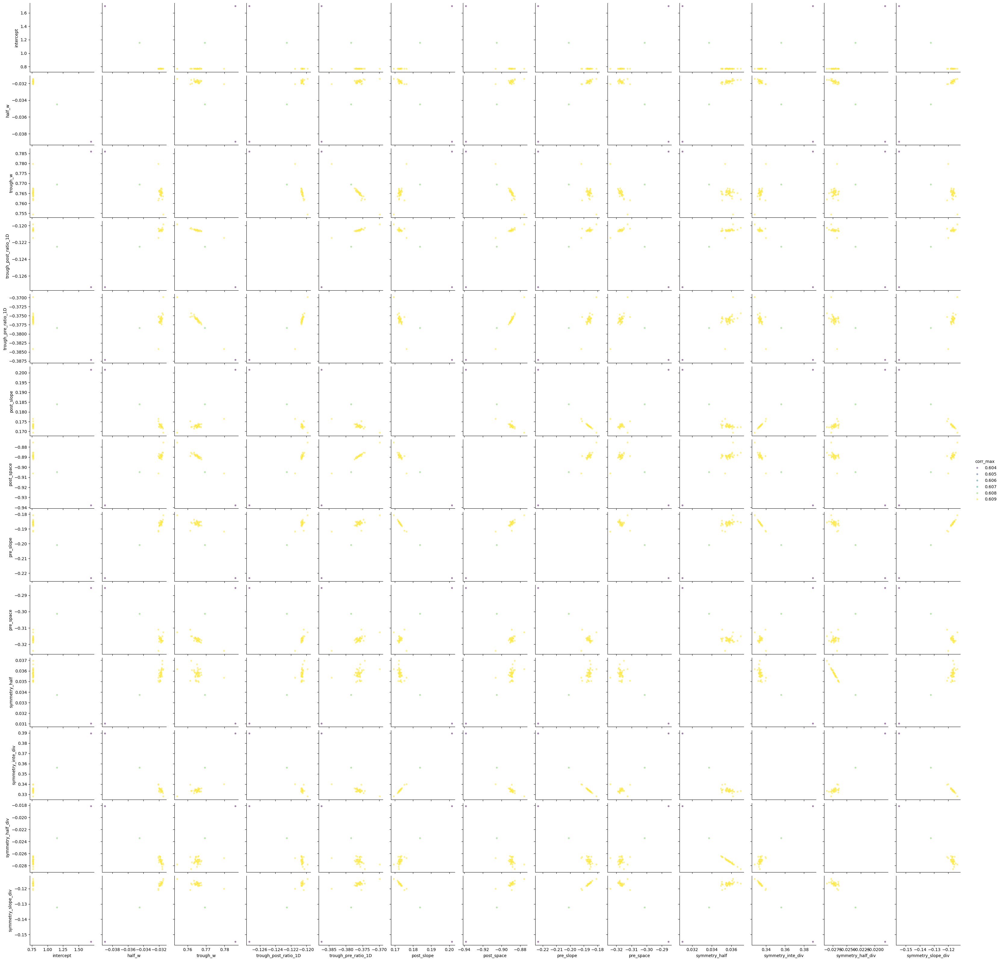

In [ ]:
g = sns.pairplot(data=w_est_df[w_est_df['corr_max']>0.6], hue='corr_max', palette='viridis', plot_kws={'alpha': 0.5, 's': 20})
g.figure.savefig(os.path.join(wf_folder, f'w_est_features_pairplot_{criteria_name}_all.png'), dpi=300)

In [406]:
cluster_id = np.zeros(len(w_est_df))
w_est_df['cluster_id'] = cluster_id

In [ ]:
# clustering based projection direction and replot weight and projection direction
from sklearn.cluster import KMeans

matrix = zscore(v_est[corr_max>=corr_cutoff], axis=0, nan_policy='omit')
cluster_id = np.full((len(v_est)), np.nan)
# Perform KMeans clustering
kmeans = KMeans(n_clusters=2, random_state=4, n_init='auto')  # Adjust n_init for sklearn >= 1.2
kmeans.fit(matrix)
labels = kmeans.labels_
cluster_id[corr_max>=corr_cutoff] = labels
w_est_df['cluster_id'] = cluster_id


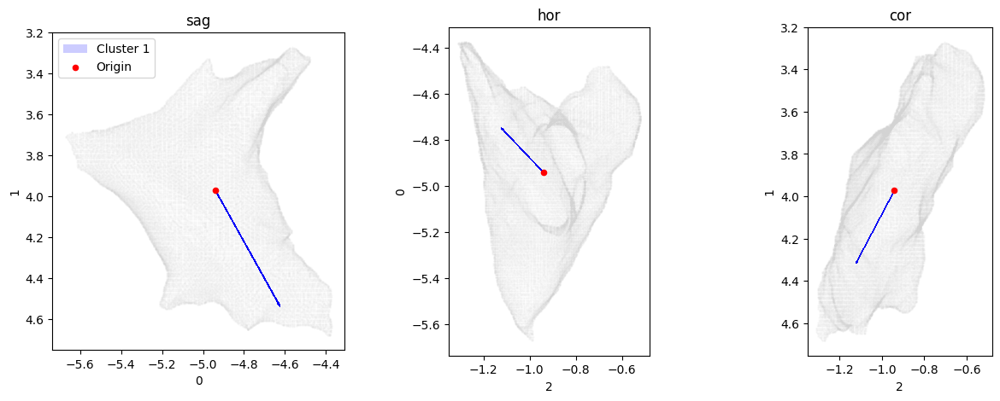

In [407]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
scale_factor = 10
# get center of LC mesh
midpoints = np.mean(mesh_vertices_mm, axis=0)
colors_cluster = ['blue', 'orange']
for ind, plane in enumerate(planes.keys()):
    # Plot the mesh
    axes[ind].scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.2)
    # Plot the vectors
    for i in range(len(np.unique(cluster_id))):
        curr_ind = np.where(cluster_id == i)[0]
        if planes[plane][1] == dv:
            axes[ind].quiver(midpoints[planes[plane][0]]*np.ones_like(curr_ind), midpoints[planes[plane][1]]*np.ones_like(curr_ind),
                            v_est[curr_ind, planes[plane][0]], -v_est[curr_ind, planes[plane][1]], color=colors_cluster[i], alpha=0.2, scale = 2, label=f'Cluster {i+1}')
        else:
            axes[ind].quiver(midpoints[planes[plane][0]]*np.ones_like(curr_ind), midpoints[planes[plane][1]]*np.ones_like(curr_ind),
                            v_est[curr_ind, planes[plane][0]], v_est[curr_ind, planes[plane][1]], color=colors_cluster[i], alpha=0.2, scale = 2, label=f'Cluster {i+1}')
    # plot origin
    axes[ind].scatter(midpoints[planes[plane][0]], midpoints[planes[plane][1]], color='r', s=20, label='Origin')
    
    axes[ind].set_title(plane)
    axes[ind].set_xlabel(planes[plane][0])
    axes[ind].set_ylabel(planes[plane][1])
    # set equal aspect ratio
    axes[ind].set_aspect('equal')
    if planes[plane][1] == dv:
        axes[ind].invert_yaxis()
    # if planes[plane][0] == ap:
    #     axes[ind].invert_xaxis
    if ind == 0:
        axes[ind].legend()
# cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=axes[2], orientation='vertical', location = 'left')
cbar.set_label('Max correlation', fontsize=12)
plt.savefig(os.path.join(wf_folder, f'v_est_cluster_color_3D_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

KeyboardInterrupt: 

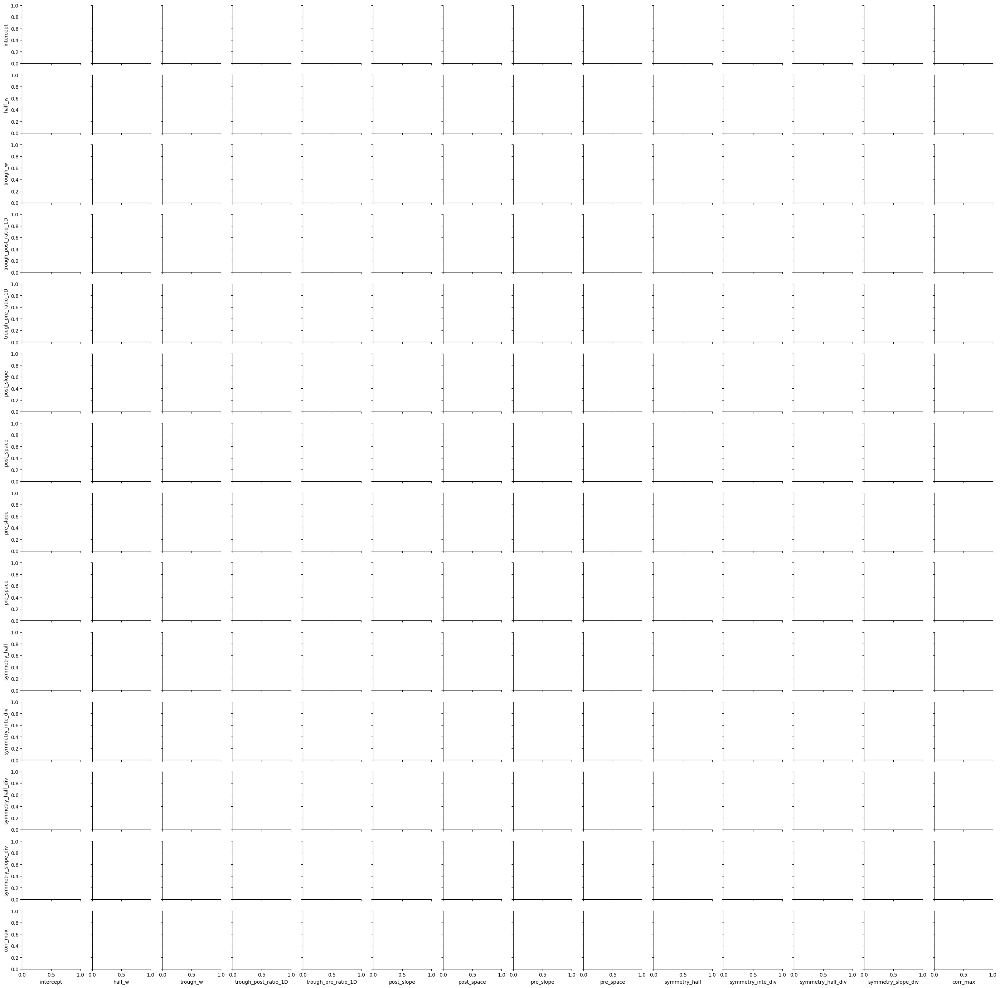

In [408]:
custom_palette={0: 'blue', 1: 'orange'}
g = sns.pairplot(data=w_est_df[corr_max>corr_cutoff], hue='cluster_id', plot_kws={'alpha': 0.5, 's': 20}, palette=custom_palette)
# limit = [np.nanmin(w_est), np.nanmax(w_est)]
# all_axes = g.axes
# for ind_x in range(len(all_axes)):
#     for ind_y in range(len(all_axes)):
#         ax = all_axes[ind_x, ind_y]
#         if ind_x != ind_y:
#             ax.set_xlim(limit)
#             ax.set_ylim(limit)
#             # Set equal aspect ratio
#             # ax.set_aspect('equal', adjustable='datalim')  # fixed issue with adjustable
#         else:
#             ax.set_xlim(limit)

g.figure.savefig(os.path.join(wf_folder, f'w_est_features_pairplot_cluster_{criteria_name}_all.png'), dpi=300)

/tmp/ipykernel_12774/1637958901.py:10: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='area'` for the same effect.
  g = sns.violinplot(data=df_melted, x='regressor', y='value', hue='cluster_id',


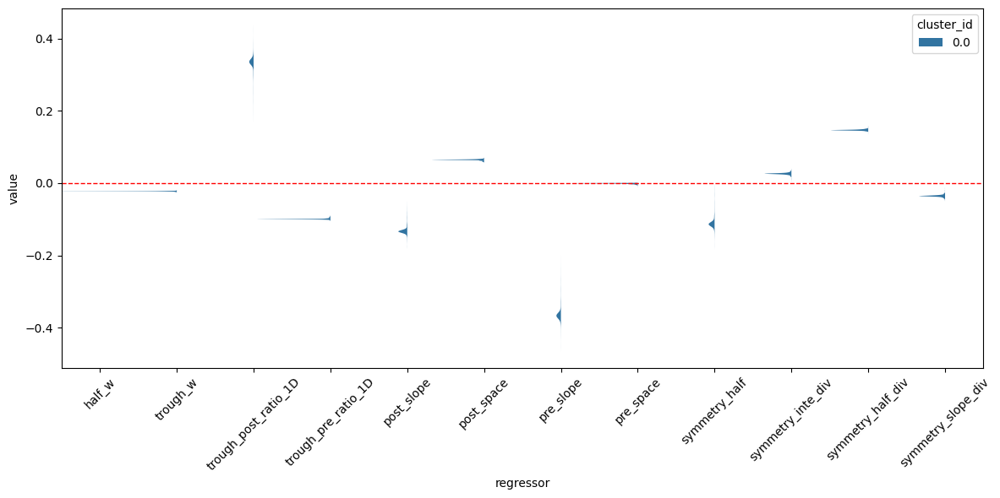

<Figure size 640x480 with 0 Axes>

In [409]:
# plot the distribution of values in w_est_df for each column as violin plots, separate by cluster
# Example: Assuming w_est_df is your DataFrame and looks like this:
# columns: ['regressor_1', 'regressor_2', ..., 'cluster_id'

# Melt dataframe to long-form
df_melted = w_est_df.drop(['intercept', 'corr_max'], axis = 1).melt(id_vars='cluster_id', var_name='regressor', value_name='value')

# Plot violin plot
plt.figure(figsize=(12, 6))
g = sns.violinplot(data=df_melted, x='regressor', y='value', hue='cluster_id',
               split=True, inner='quartile', scale='area', width=2, linecolor='none')
plt.axhline(y=0, color='r', linestyle='--', linewidth=1)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
plt.savefig(os.path.join(wf_folder, f'w_est_features_violin_plot_cluster_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


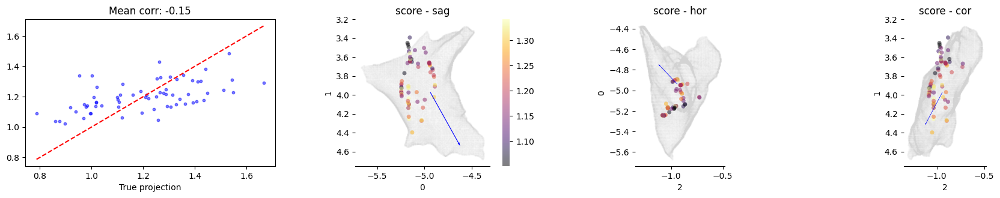

In [491]:
# plot correlation and colorcode for two clusters
fig = plt.figure(figsize=(18, 6))
gs = plt.GridSpec(2, 4)
for ind, curr_cluster in enumerate(range(len(np.unique(cluster_id)))):
    # find the maximum correlation in each cluster
    max_ind = np.argmax(corr_max[cluster_id == curr_cluster])
    w_est_curr = w_est[cluster_id == curr_cluster][max_ind]
    v_est_curr = v_est[cluster_id == curr_cluster][max_ind]
    proj_3D = P[mask] @ v_est_curr
    proj_3D_3D = np.outer(proj_3D, v_est_curr)
    proj_feature = X_features_zs @ w_est_curr
    # plot the correlation
    ax = fig.add_subplot(gs[ind, 0])
    ax.scatter(proj_3D, proj_feature, alpha=0.5, color=colors_cluster[ind], s=10)
    ax.plot([proj_3D.min(), proj_3D.max()],
             [proj_3D.min(), proj_3D.max()], 'r--')
    corr_mean = np.mean(corr_max[cluster_id == curr_cluster])
    ax.set_xlabel('True projection')
    ax.set_title(f'Mean corr: {corr_mean:.2f}')
    norm = Normalize(vmin=np.quantile(proj_feature, 0.05), vmax=np.quantile(proj_feature, 0.95))
    feature_cmap = proj_feature
    feature_cmap[feature_cmap < np.quantile(proj_feature, 0.05)] = np.quantile(proj_feature, 0.05)
    feature_cmap[feature_cmap > np.quantile(proj_feature, 0.95)] = np.quantile(proj_feature, 0.95)

    # in 3D space
    for plane, ax_ind in zip(planes.keys(), range(3)):
        ax = fig.add_subplot(gs[ind, ax_ind+1])
        # Plot the mesh
        ax.scatter(mesh_vertices_mm[:, planes[plane][0]], mesh_vertices_mm[:, planes[plane][1]], color='lightgray', alpha=0.1, s = 0.05)
        # Plot the points
        sc = ax.scatter(ccfs[mask, planes[plane][0]], ccfs[mask, planes[plane][1]], c= feature_cmap, cmap='inferno', s=25, edgecolor='none', alpha=0.5)

        # plot the projection vector
        if planes[plane][1] == dv:
            ax.quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est_curr[planes[plane][0]], -v_est_curr[planes[plane][1]], color=colors_cluster[ind], alpha=1, scale = 2, width=0.005)
        else:
            ax.quiver(midpoints[planes[plane][0]], midpoints[planes[plane][1]],
                        v_est_curr[planes[plane][0]], v_est_curr[planes[plane][1]], color=colors_cluster[ind], alpha=1, scale = 2, width=0.005)
        # scatter antidromic 
        anti = combined_tagged_units_filtered[mask]['anti_resp'].values <= 2
        # ax.scatter(ccfs[mask, planes[plane][0]][anti], ccfs[mask, planes[plane][1]][anti], color='none', alpha=1, s = 40, edgecolor='r', linewidth = 1, label='Antidromic')
        ax.set_title(f'{feature} - {plane}')
        ax.set_xlabel(planes[plane][0])
        ax.set_ylabel(planes[plane][1])
        # remove boxes
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # set equal aspect ratio
        ax.set_aspect('equal')
        if planes[plane][1] == dv:
            ax.invert_yaxis()
        if plane == 'sag':
            cbar = fig.colorbar(sc, ax=ax)
            cbar.outline.set_visible(False)
            # cbar.ax.set_visible(False)

plt.tight_layout()

plt.savefig(os.path.join(wf_folder, f'w_v_est_pred_color_2D_{criteria_name}.svg'), dpi=300, bbox_inches='tight')


In [377]:
# pick max_corr
if len(np.unique(v_est[:,0])) == 1:
    # pick the min distance
    opt_ind = np.argmin(dis_min) 
else:
    opt_ind = np.argmax(corr_max)

w_est_opt = w_est[opt_ind]
v_est_opt = v_est[opt_ind]
proj_3D = P[mask] @ v_est_opt
pred = X_features_zs @ w_est_opt


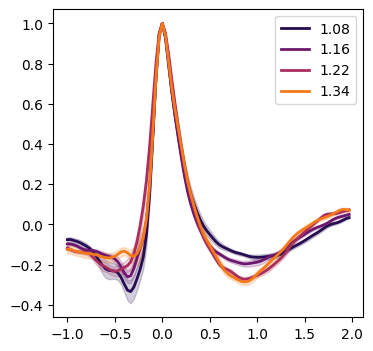

In [440]:
num_bins = 4
edges = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
# edges = np.linspace(np.min(proj_3D), np.max(proj_3D), num_bins + 1)
# norm = Normalize(vmin=np.quantile(proj_feature, 0.05), vmax=np.quantile(proj_feature, 0.95))
norm = Normalize(vmin=np.min(pred), vmax=np.max(pred))
group_mean = [np.mean(pred[(pred >= edges[ind]) & (pred < edges[ind + 1])]) for ind in range(num_bins)]
colors_groups = plt.cm.inferno(norm(group_mean))
wf_ccf = all_wfs_aligned_nl[mask,:]
wf_time = (np.arange(wf_ccf.shape[1]) - 30)*1000/30000

fig, ax = plt.subplots(figsize=(4, 4))

for ind in range(num_bins):
    bin_indices = np.where((pred >= edges[ind]) & (pred < edges[ind + 1]))[0]
    # plot the points in the current bin
    wf_mean = np.nanmean(wf_ccf[bin_indices], axis=0)
    wf_se = np.nanstd(wf_ccf[bin_indices], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[bin_indices]), axis=0))
    ax.plot(wf_time, wf_mean, color=colors_groups[ind], linewidth=2, label=f'{group_mean[ind]:.2f}')
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color=colors_groups[ind], alpha=0.2)
ax.legend()

plt.savefig(os.path.join(wf_folder, f'pred_vs_wf_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')

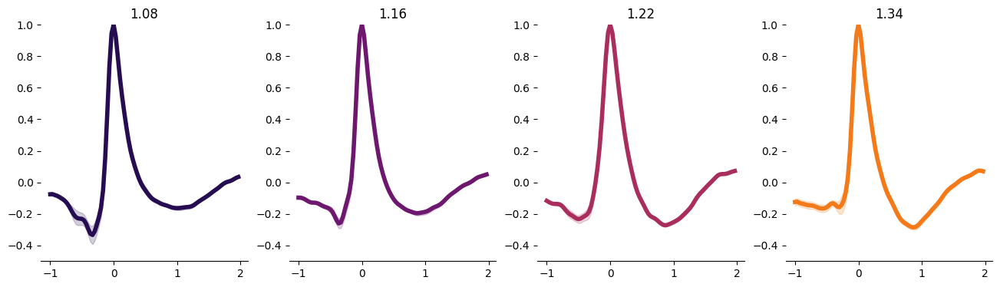

In [437]:
num_bins = 4
edges = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
# edges = np.linspace(np.min(proj_3D), np.max(proj_3D), num_bins + 1)
norm = Normalize(vmin=np.min(pred), vmax=np.max(pred))
group_mean = [np.mean(pred[(pred >= edges[ind]) & (pred < edges[ind + 1])]) for ind in range(num_bins)]
colors_groups = plt.cm.inferno(norm(group_mean))
wf_ccf = all_wfs_aligned_nl[mask,:]
wf_time = (np.arange(wf_ccf.shape[1]) - 30)*1000/30000

fig, axes = plt.subplots(1, num_bins, figsize=(4*num_bins, 4))
wf_lim = [-0.5, 1]
for ind in range(num_bins):
    bin_indices = np.where((pred >= edges[ind]) & (pred < edges[ind + 1]))[0]
    # plot the points in the current bin
    wf_mean = np.nanmean(wf_ccf[bin_indices], axis=0)
    wf_se = np.nanstd(wf_ccf[bin_indices], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[bin_indices]), axis=0))
    ax = axes[ind]
    ax.plot(wf_time, wf_mean, color=colors_groups[ind], linewidth=4)
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color=colors_groups[ind], alpha=0.2)
    ax.set_title(f'{group_mean[ind]:.2f}')
    # turn off the box
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_ylim(wf_lim)

plt.savefig(os.path.join(wf_folder, f'pred_vs_wf_{criteria_name}_all.pdf'), dpi=300, bbox_inches='tight')
    

In [432]:
# save wf_ccf
wf_ccf = all_wfs_aligned_nl[mask,:]

np.save(os.path.join(wf_folder, 'waveforms.npy'), wf_ccf)

In [434]:
len(wf_ccf)

66

<Figure size 800x600 with 0 Axes>

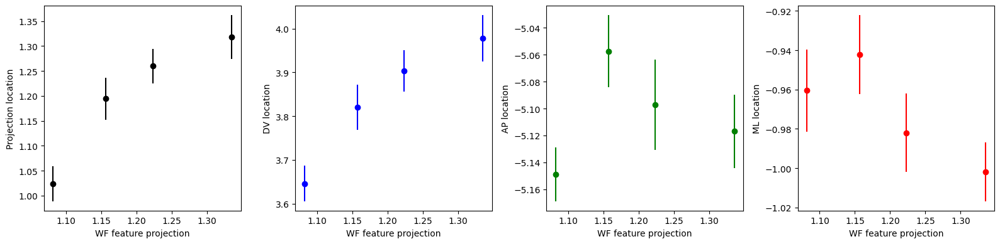

In [429]:
# Projection number vs waveform feature
plt.figure(figsize=(8, 6))
dv_loc = P[mask][:, dv]
num_bins = 4
edges_proj = np.linspace(np.min(pred), np.max(pred), num_bins + 1)
edges_proj = np.quantile(pred, np.linspace(0, 1, num_bins + 1))
proj_mean = np.zeros(num_bins)
proj_se = np.zeros(num_bins)
pred_mean = np.zeros(num_bins)
dv_mean = np.zeros(num_bins)
dv_se = np.zeros(num_bins)
ap_mean = np.zeros(num_bins)
ap_se = np.zeros(num_bins)
ml_mean = np.zeros(num_bins)   
ml_se = np.zeros(num_bins)

for ind_bin in range(num_bins):
    bin_indices = np.where((pred >= edges_proj[ind_bin]) & (pred < edges_proj[ind_bin + 1]))[0]
    pred_mean[ind_bin] = np.nanmean(pred[bin_indices])
    proj_mean[ind_bin] = np.nanmean(proj_3D[bin_indices])
    proj_se[ind_bin] = np.nanstd(proj_3D[bin_indices])/np.sqrt(np.sum(~np.isnan(proj_3D[bin_indices]), axis=0))
    dv_mean[ind_bin] = np.nanmean(P[mask][bin_indices, dv])
    dv_se[ind_bin] = np.nanstd(P[mask][bin_indices, dv])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, dv]), axis=0))
    ap_mean[ind_bin] = np.nanmean(P[mask][bin_indices, ap])
    ap_se[ind_bin] = np.nanstd(P[mask][bin_indices, ap])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, ap]), axis=0))
    ml_mean[ind_bin] = np.nanmean(P[mask][bin_indices, ml])
    ml_se[ind_bin] = np.nanstd(P[mask][bin_indices, ml])/np.sqrt(np.sum(~np.isnan(P[mask][bin_indices, ml]), axis=0))

fig, axes = plt.subplots(1, 4, figsize=(16, 4))
axes[0].errorbar(pred_mean, proj_mean, yerr=proj_se, fmt='o', color='k', label='Projection')
axes[0].set_xlabel('WF feature projection')
axes[0].set_ylabel('Projection location')

axes[1].errorbar(pred_mean, dv_mean, yerr=dv_se, fmt='o', color='b', label='DV')
axes[1].set_xlabel('WF feature projection')
axes[1].set_ylabel('DV location')

axes[2].errorbar(pred_mean, ap_mean, yerr=ap_se, fmt='o', color='g', label='AP')
axes[2].set_xlabel('WF feature projection')
axes[2].set_ylabel('AP location')

axes[3].errorbar(pred_mean, ml_mean, yerr=ml_se, fmt='o', color='r', label='ML')
axes[3].set_xlabel('WF feature projection')
axes[3].set_ylabel('ML location')

plt.tight_layout()

fig.savefig(os.path.join(wf_folder, f'projection_vs_location_{criteria_name}.pdf'), dpi=300, bbox_inches='tight')


    

In [430]:
# save data
wf_features_ccf = wf_features[mask].copy()
wf_features_ccf.reset_index(drop=True, inplace=True)
wf_features_ccf['proj'] = proj_3D
wf_features_ccf['feature_pred'] = pred
wf_features_ccf['ccf'] = list(P[mask])
wf_features_ccf['wf_nl'] = list(all_wfs_aligned_nl[mask,:])

# save wf_features_ccf, w_est_opt, v_est_opt, corr_max in a single pickle file
data = {}
data['wf_df'] = wf_features_ccf
data['w_est'] = w_est_opt
data['v_est'] = v_est_opt
data['corr_max'] = corr_max
data['ccf'] = P[mask]
data['wf_nl'] = all_wfs_aligned_nl[mask,:]
with open(os.path.join(wf_folder, f'projection_data_{criteria_name}.pkl'), 'wb') as f:
    pickle.dump(data, f)


In [270]:
# find antidromic neurons
len(combined_tagged_units_filtered), len(wf_features_ccf)

(167, 66)

In [271]:
combined_tagged_units_filtered[mask]['anti_resp'].values

array([nan,  3., nan,  3.,  3., nan, nan, nan, nan, nan, nan, nan,  2.,
        3., nan, nan, nan, nan,  2., nan, nan, nan, nan, nan, nan, nan,
        3., nan, nan, nan, nan, nan, nan, nan,  2.,  2., nan, nan, nan,
       nan, nan, nan,  3., nan, nan, nan, nan,  3., nan, nan, nan,  2.,
        2.,  2., nan,  1., nan,  1.,  2., nan, nan, nan,  2.,  1.,  2.,
        1.])

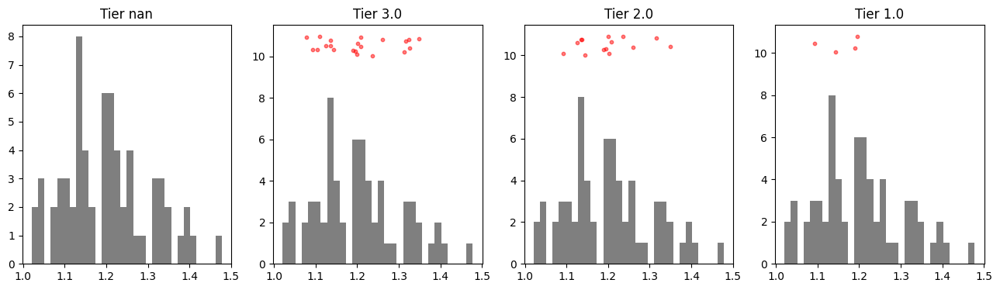

In [273]:
fig, axes = plt.subplots(1, len(combined_tagged_units_filtered[mask]['anti_resp'].unique()), figsize=(16, 4))
for ind, tier in enumerate(combined_tagged_units_filtered[mask]['anti_resp'].unique()):
    ax = axes[ind]
    ax.hist(wf_features_ccf['feature_pred'], bins=30, color='k', alpha=0.5)
    ax.scatter(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]['feature_pred'], np.random.rand(len(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier])) + 10, color='r', alpha=0.5, s=10, label=f'{tier} ms')
    ax.set_title(f'Tier {tier}')

/opt/conda/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/conda/lib/python3.10/site-packages/numpy/_core/_methods.py:147: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_12774/598732996.py:7: RuntimeWarning: Mean of empty slice
  wf_mean = np.nanmean(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)
/opt/conda/lib/python3.10/site-packages/numpy/lib/_nanfunctions_impl.py:2053: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


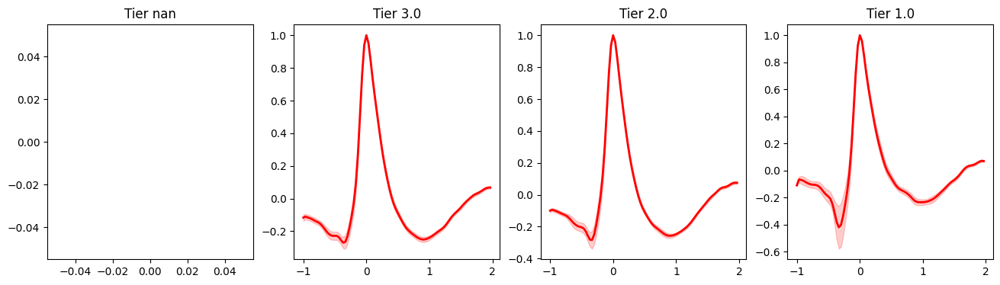

In [288]:
# mean wf for each tier
fig, axes = plt.subplots(1, len(combined_tagged_units_filtered[mask]['anti_resp'].unique()), figsize=(16, 4))
for ind, tier in enumerate(combined_tagged_units_filtered[mask]['anti_resp'].unique()):
    ax = axes[ind]
    group_mean = np.mean(wf_features_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]['feature_pred'].values)
    colors_group = plt.cm.viridis(norm(group_mean))
    wf_mean = np.nanmean(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)
    wf_se = np.nanstd(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier], axis=0)/np.sqrt(np.sum(~np.isnan(wf_ccf[combined_tagged_units_filtered[mask]['anti_resp'].values <= tier]), axis=0))
    ax.plot(wf_time, wf_mean, color='r', linewidth=2, label=f'{tier} ms')
    ax.fill_between(wf_time, wf_mean - wf_se, wf_mean + wf_se, color='r', alpha=0.2)
    ax.set_title(f'Tier {tier}')
fig.savefig(os.path.join(wf_folder, f'anti_resp_tiers.pdf'), dpi=300, bbox_inches='tight')

In [ ]:
# # grab all tagged units and combine a pdf
# data_type = 'curated'
# target = 'soma'
# selected_sessions = []
# selected_units = []
# all_pdf = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         session_dir = session_dirs(session)
#         # # opto_file
#         # all_pdfs = os.listdir(session_dir[f'opto_dir_fig_{data_type}'])
#         # pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         # pdf_path = os.path.join(session_dir[f'opto_dir_fig_{data_type}'], pdf)
#         # # copy to new path
#         # new_path_opto = os.path.join('/root/capsule/scratch/combined/opto_tagged', f'{session}_{pdf}')
#         # _ = shutil.copy(pdf_path, new_path_opto)

#         # selected_sessions.append(session)
#         # selected_units.append(unit)
#         # all_pdf.append(pdf_path)

#         # # behavior file: go cue
#         # all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue'))
#         # pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         # pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'go_cue', pdf)
#         # # copy to new path
#         # new_path_ephys = os.path.join('/root/capsule/scratch/combined/behavior_tagged_go_cue', f'{session}_{pdf}')
#         # _ = shutil.copy(pdf_path, new_path_ephys)

#         # behavior file: go cue
#         all_pdfs = os.listdir(os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response'))
#         pdf = [pdf for pdf in all_pdfs if f'unit_{unit}_' in pdf and pdf.endswith('.pdf')][0]
#         pdf_path = os.path.join(session_dir[f'ephys_fig_dir_{data_type}'], 'response', pdf)
#         # copy to new path
#         new_path_ephys = os.path.join('/root/capsule/scratch/combined/behavior_tagged_response', f'{session}_{pdf}')
#         _ = shutil.copy(pdf_path, new_path_ephys)


In [ ]:
# opto_sessions = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         opto_sessions.append(session)

# opto_sessions = list(set(opto_sessions))

# for session in opto_sessions:
#     session_dir = session_dirs(session)
#     opto_summary_file = os.path.join(session_dir[f'opto_dir_{data_type}'], f"{session}_{data_type}_{target}_opto_summary.pdf")
#     if os.path.exists(opto_summary_file):
#         new_path = os.path.join('/root/capsule/scratch/combined/opto_summary', f'{session}_opto_summary.pdf')
#         _ = shutil.copy(opto_summary_file, new_path)


In [ ]:
# opto_sessions = []
# for session, unit, tag, qc in zip(all_sessions, all_units, all_tagged_units, all_qc_pass_units):
#     if tag and qc:
#         opto_sessions.append(session)

# opto_sessions = list(set(opto_sessions))

# for session in opto_sessions:
#     session_dir = session_dirs(session)
#     waveform_summary_file = os.path.join(session_dir[f'ephys_dir_{data_type}'], "waveforms_recompute.pdf")
#     if os.path.exists(waveform_summary_file):
#         new_path = os.path.join('/root/capsule/scratch/combined/waveform_summary', f'{session}_waveform_recompute.pdf')
#         _ = shutil.copy(waveform_summary_file, new_path)

In [ ]:
# # combine_pdf_big('/root/capsule/scratch/combined/opto_tagged', os.path.join('/root/capsule/scratch/combined', 'opto_tagged_combined.pdf'))
# # combine_pdf_big('/root/capsule/scratch/combined/behavior_tagged_go_cue', os.path.join('/root/capsule/scratch/combined', 'behavior_ephys_tagged_go_cue_combined.pdf'))

# # combine_pdf_big('/root/capsule/scratch/combined/behavior_tagged_response', os.path.join('/root/capsule/scratch/combined', 'behavior_ephys_tagged_response_combined.pdf'))
# combine_pdf_big('/root/capsule/scratch/combined/opto_summary', os.path.join('/root/capsule/scratch/combined', 'opto_probe_summary.pdf'))